<a href="https://colab.research.google.com/github/shirshir05/ATP-Project-PartC/blob/master/Exam_315805168.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Germany COVID**

# **Install packge**

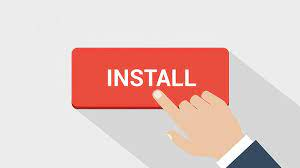

In [ ]:
!pip install geopy
!pip install geopandas
!pip install cartopy
!pip install --no-binary shapely shapely --force
!pip install turicreate
!pip install networkx
!pip install python-igraph
!pip install pyLDAvis
# !pip install pandas=1.3.1
!pip install pandas --upgrade

     |████████████████████████████████| 1.0 MB 13.9 MB/s 
     |████████████████████████████████| 15.4 MB 67.0 MB/s 
     |████████████████████████████████| 6.3 MB 69.6 MB/s 
     |████████████████████████████████| 10.8 MB 13.5 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... error
     |████████████████████████████████| 10.8 MB 53.6 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... error
     |████████████████████████████████| 10.8 MB 54.6 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... error
     |████████████████████████████████| 12.1 MB 59.2 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 219 kB 49.7 MB/s 
  Created wheel for cartopy: filename=Cartopy-0.19.0.post1-cp37-cp37m-linux_x86_64.whl size=12516281 sha256=338b4d4bb3ee615bd7f6ce4488c95d

     |████████████████████████████████| 3.1 MB 14.4 MB/s 
     |████████████████████████████████| 1.7 MB 15.1 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 11.3 MB 64.9 MB/s 
     |████████████████████████████████| 15.7 MB 72.3 MB/s 
  Created wheel for pyLDAvis: filename=pyLDAvis-3.3.1-py2.py3-none-any.whl size=136898 sha256=004162ea2d0cbf4c1ece7f0d6aedea856ef51c033c6a5006dbceeaf5b813e98a
  Stored in directory: /root/.cache/pip/wheels/c9/21/f6/17bcf2667e8a68532ba2fbf6d5c72fdf4c7f7d9abfa4852d2f
Successfully built pyLDAvis
  Attempting uninstall: numpy
    Found existing installation: numpy 1.18.5
    Uninstalling numpy-1.18.5:
      Successfully uninstalled numpy-1.18.5
  Attempting uninstall: pandas
    Found existing installation: pandas 1.1.5
    Uninstalling pandas-1.1.5:
      Successfully uninstalled pandas-1.1.5


# **Import**

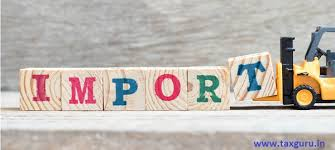

In [ ]:
import gensim
from gensim.models import LsiModel, LdaModel
from gensim.corpora import Dictionary
import pyLDAvis.gensim_models
import requests
import altair as alt
from bs4 import BeautifulSoup
import pandas as pd
from geopy.geocoders import Nominatim
import numpy as np
import os
import csv
import networkx as nx
import turicreate as tc
from datetime import datetime
import pandas as pd
import plotly.graph_objects as go
# import plotly.express as px
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
import re
import requests
from bs4 import BeautifulSoup
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from collections import Counter
import geopandas
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import folium
import matplotlib.pyplot as plt
import turicreate.aggregate as agg
import re
import itertools
import pandas as pd
from textblob import TextBlob
import tweepy
from tweepy import OAuthHandler
import operator
import seaborn as sns

import turicreate as tc
from nltk.corpus import stopwords
from nltk.stem.porter import *
from functools import lru_cache
from collections import Counter
from nltk.tokenize import word_tokenize
import nltk


/usr/local/lib/python3.7/dist-packages/past/types/oldstr.py:5: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  from collections import Iterable
/usr/local/lib/python3.7/dist-packages/nltk/decorators.py:70: DeprecationWarning: `formatargspec` is deprecated since Python 3.5. Use `signature` and the `Signature` object directly
  formatvalue=lambda value: "")[1:-1]
/usr/local/lib/python3.7/dist-packages/scipy/io/matlab/mio5.py:98: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  from .mio5_utils import VarReader5


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# **Usefual function (reuse code)**

In [ ]:
def split_column_by_hyphen(df, column_name, delimiter="/"):
  """
  The function split column in foramt year-motha-day.
  The column name remove from the sframe.
  Args:
      df (sfarme):
      column_name (str):
      delimiter (str):
  Returns: new sframe
  """
  df[column_name + "_split"] = df[column_name].apply(lambda x: x.split(delimiter))
  df['day'] = df[column_name + "_split"].apply(lambda x: int(x[0]))
  df['month'] = df[column_name + "_split"].apply(lambda x:  int(x[1]))
  df['year'] = df[column_name + "_split"].apply(lambda x:  int(x[2].split(" ")[0]))
  df.pop(column_name + "_split")
  return df

In [ ]:
def time_plot(y_axis, title_text, color='firebrick'):
  # royalblue, 'rgb(204, 204, 204)', 'rgb(82, 82, 82)',
  fig = go.Figure()

  fig.add_trace(
      go.Scatter(x=[datetime.strptime(i,"%d/%m/%Y") for i in list(owid_data_ger.date)], y=list(y_axis), line=dict(color=color)))
  fig.update_layout(title_text=title_text)

  fig.update_layout(
      xaxis=dict(rangeselector=dict(buttons=list([dict(count=1,label="1m",
      step="month",stepmode="backward"),dict(count=6,label="6m",step="month",
      stepmode="backward"),dict(count=1,label="YTD",step="year",
      stepmode="todate"),dict(count=1,label="1y",step="year",
      stepmode="backward"),dict(step="all")])),rangeslider=dict(visible=True),
      type="date"))
  fig.show()

In [ ]:
def geolocate(country):
    try:
        loc = geolocator.geocode(country)
        return loc.latitude, loc.longitude
    except:
        # Return missing value
        return 'None'

In [ ]:
def bar_category(df, x_axis, y_axis, category, title):
  g= sns.catplot(x=x_axis, y=y_axis, hue=category, kind="bar", data=df)
  g.ax.set_title(title)
  g.fig.set_size_inches(17,5)

# **Read Data**

In [ ]:
data_covid_de = pd.read_csv(os.path.join('drive', 'MyDrive', 'Exam_COVID', 'Data', 'covid.csv'))

In [ ]:
owid_data = pd.read_csv(os.path.join('drive', 'MyDrive', 'Exam_COVID', 'Data', 'owid-covid-data.csv'))
owid_data_ger = owid_data[owid_data['location'] == 'Germany']
owid_data_ger = split_column_by_hyphen(owid_data_ger, 'date')
# owid_data_ger['date'] = [datetime.strptime(i, '%d/%m/%Y') for i in list(owid_data_ger.date) ]
group = owid_data_ger.groupby(['year', 'month'], as_index=False).sum()
group = group[group['year'] != 2022]
group = group[(group['month'] != 12) & (group['month']  != 11)]

In [ ]:
employment_data = pd.read_csv(os.path.join('drive', 'MyDrive', 'Exam_COVID', 'Data', 'employment.csv'))

In [ ]:
data_covid_de = pd.read_csv(os.path.join('drive', 'MyDrive', 'Exam_COVID', 'Data', 'covid.csv'))

In [ ]:
tourism_data = pd.read_csv(os.path.join('drive', 'MyDrive', 'Exam_COVID', 'Data', 'Tourism.csv'))
tourism_data = tourism_data[(tourism_data['month'] != 'Dezember') & (tourism_data['month']  != 'November')]

# **Background on Germany**

In [ ]:
geolocator = Nominatim(user_agent="SkittBot")
state = set(data_covid_de['state'])
dcit_state = {}
for i in state:
  dcit_state[i] = geolocate(i)

In [ ]:
m = folium.Map(location=[51.1657, 10.4515])
for i in dcit_state:
  if dcit_state[i] != 'None':
    folium.Marker(
      location=[dcit_state[i][0], dcit_state[i][1]], # coordinates for the marker (Earth Lab at CU Boulder)
      popup="here " + i, tooltip="Click me!"
      ).add_to(m)
m

# **Information updates over time**

In [ ]:
url = "https://www.worldometers.info/coronavirus/country/germany/"
s = requests.get(url).content.decode('utf-8')
soup = BeautifulSoup(s, 'html.parser')
data = soup.findAll(['div'], attrs={'class': 'maincounter-number'})
dict_ = {"Coronavirus Cases": int(str(data[0].findAll('span')[0]).split(">")[1].split("<")[0].replace(",", "")),
         "Deaths:": int(str(data[1].findAll('span')[0]).split(">")[1].split("<")[0].replace(",", "")),
         "Recovered:": int(str(data[2].findAll('span')[0]).split(">")[1].split("<")[0].replace(",", ""))}
print(dict_)

{'Coronavirus Cases': 9145274, 'Deaths:': 117883, 'Recovered:': 7443300}


# **Map**

In [ ]:
dcit_state

{'Baden-Wuerttemberg': (49.47411555, 8.534834379338445),
 'Bayern': (48.91752975, 12.048021365471286),
 'Berlin': (52.5170365, 13.3888599),
 'Brandenburg': (52.8455492, 13.2461296),
 'Bremen': (53.0758196, 8.8071646),
 'Hamburg': (53.550341, 10.000654),
 'Hessen': (50.6080651, 9.0284647),
 'Mecklenburg-Vorpommern': (53.7735064, 12.5755471),
 'Niedersachsen': (52.8398531, 9.075962),
 'Nordrhein-Westfalen': (51.4789205, 7.5543751),
 'Rheinland-Pfalz': (49.9531599, 7.310646),
 'Saarland': (49.3841872, 6.9537369),
 'Sachsen': (50.9295798, 13.4585052),
 'Sachsen-Anhalt': (52.0089065, 11.7003344),
 'Schleswig-Holstein': (54.1853998, 9.8220089),
 'Thueringen': (50.7730556, 10.8937217)}

In [ ]:
def county_position(i):
    try:
      val_1, val_2 = dcit_state[i][0], dcit_state[i][1]
      return val_1, val_2
    except Exception as e:
      return None, None

data_covid_de['latitude'], data_covid_de['longitude'] =  zip(*data_covid_de['state'].map(county_position))

In [ ]:
import plotly.express as px
fig = px.scatter_geo(data_covid_de, 
                     lat='latitude', 
                     lon='longitude', 
                     scope='europe',
                     color="cases", 
                     size='cases',
                     text='county',
                    #  projection="albers usa", 
                     animation_frame="date", 
                     title='Your title')
fig.update(layout_coloraxis_showscale=False)
fig.show()

/usr/local/lib/python3.7/dist-packages/yaml/constructor.py:126: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  if not isinstance(key, collections.Hashable):
/usr/local/lib/python3.7/dist-packages/dask/array/numpy_compat.py:21: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  np.divide(0.4, 1, casting="unsafe", dtype=np.float),


In [ ]:
plt.figure(figsize=(20, 20))
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0))
ax.set_extent([0, 60, 20, 60])  # Select a specific part of the map
ax.coastlines(resolution='10m', color='black', linewidth=1) # draw with batter coaslines resolution
ax.stock_img() # add colors 

germany_lon, germany_lat = 10.4515, 51.1657
plt.plot(germany_lon, germany_lat,
         color='blue', marker='o', markersize=8
         )
ax.text(10.4515, 51.1657, 'Germany', fontsize=14)

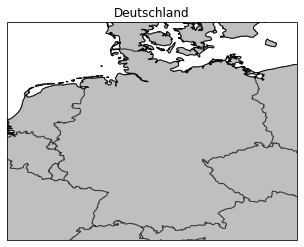

In [ ]:
def draw_us_map():
  import cartopy.crs as ccrs
  import cartopy.io.shapereader as shpreader
  import matplotlib.pyplot as plt

  # Downloaded from http://biogeo.ucdavis.edu/data/gadm2/shp/DEU_adm.zip
  fname = os.path.join('drive', 'MyDrive', 'Exam_COVID', 'Data','ne_10m_admin_0_countries_deu.shx')

  adm1_shapes = list(shpreader.Reader(fname).geometries())

  ax = plt.axes(projection=ccrs.PlateCarree())

  plt.title('Deutschland')
  ax.coastlines(resolution='10m')

  ax.add_geometries(adm1_shapes, ccrs.PlateCarree(),
                    edgecolor='black', facecolor='gray', alpha=0.5)

  ax.set_extent([4, 16, 47, 56], ccrs.PlateCarree())
  return ax
draw_us_map()

In [ ]:
# These examples are inspired from http://geopandas.org/mapping.html
import geopandas
import matplotlib.pyplot as plt
%matplotlib inline
gdf = geopandas.GeoDataFrame(data_covid_de, geometry=geopandas.points_from_xy(data_covid_de.longitude, data_covid_de.latitude	))

,Unnamed: 0,county,age_group,gender,date,cases,deaths,recovered,latitude,longitude,geometry
state,,,,,,,,,,,
Baden-Wuerttemberg,181272,181272,180891,178014,181272,181272,181272,181272,181272,181272,181272
Bayern,317447,317447,317171,308796,317447,317447,317447,317447,317447,317447,317447
Berlin,52862,52862,52459,50370,52862,52862,52862,52862,52862,52862,52862
Brandenburg,54392,54392,54269,52897,54392,54392,54392,54392,54392,54392,54392
Bremen,8575,8575,8522,8381,8575,8575,8575,8575,8575,8575,8575
Hamburg,7469,7469,7405,6764,7469,7469,7469,7469,7469,7469,7469
Hessen,102063,102063,101602,98696,102063,102063,102063,102063,102063,102063,102063
Mecklenburg-Vorpommern,24151,24151,24066,23978,24151,24151,24151,24151,24151,24151,24151
Niedersachsen,130022,130022,129815,127186,130022,130022,130022,130022,130022,130022,130022


In [ ]:
[(idx, row['longitude'], row['cases']) for idx, row in data_covid_de.groupby("state").count().iterrows()] 

[('Baden-Wuerttemberg', 181272, 181272),
 ('Bayern', 317447, 317447),
 ('Berlin', 52862, 52862),
 ('Brandenburg', 54392, 54392),
 ('Bremen', 8575, 8575),
 ('Hamburg', 7469, 7469),
 ('Hessen', 102063, 102063),
 ('Mecklenburg-Vorpommern', 24151, 24151),
 ('Niedersachsen', 130022, 130022),
 ('Nordrhein-Westfalen', 243550, 243550),
 ('Rheinland-Pfalz', 102453, 102453),
 ('Saarland', 20693, 20693),
 ('Sachsen', 53812, 53812),
 ('Sachsen-Anhalt', 43086, 43086),
 ('Schleswig-Holstein', 43628, 43628),
 ('Thueringen', 64001, 64001)]

In [ ]:
import folium
from folium.plugins import HeatMap

m = folium.Map(location=[0,0], zoom_start=2,
               tiles =  'Stamen Terrain')
data = [(dcit_state[idx][0],dcit_state[idx][1], row['cases']) for idx, row in data_covid_de.groupby("state").count().iterrows()] 
HeatMap(data, radius = 20).add_to(m)
m

In [ ]:
m

In [ ]:
import folium
from folium.plugins import HeatMap

m = folium.Map(location=[0,0], zoom_start=2,
               tiles =  'Stamen Terrain')
data = [(dcit_state[i][0],dcit_state[i][1]) for i in dcit_state] # ,r['Magnitude']
HeatMap(data, radius = 20).add_to(m)
m

In [ ]:
data_covid_de

,Unnamed: 0,state,county,age_group,gender,date,cases,deaths,recovered,latitude,longitude
0,0,Baden-Wuerttemberg,LK Alb-Donau-Kreis,00-04,F,2020-03-27,1,0,1,None,None
1,1,Baden-Wuerttemberg,LK Alb-Donau-Kreis,00-04,F,2020-03-28,1,0,1,None,None
2,2,Baden-Wuerttemberg,LK Alb-Donau-Kreis,00-04,F,2020-04-03,1,0,1,None,None
3,3,Baden-Wuerttemberg,LK Alb-Donau-Kreis,00-04,F,2020-10-18,1,0,1,None,None
4,4,Baden-Wuerttemberg,LK Alb-Donau-Kreis,00-04,F,2020-10-22,1,0,1,None,None
...,...,...,...,...,...,...,...,...,...,...,...
1449471,1449471,Thueringen,SK Weimar,NaN,F,2021-12-11,1,0,1,None,None
1449472,1449472,Thueringen,SK Weimar,NaN,F,2021-12-23,1,0,1,None,None
1449473,1449473,Thueringen,SK Weimar,NaN,F,2022-01-13,1,0,0,None,None
1449474,1449474,Thueringen,SK Weimar,NaN,M,2021-12-23,1,0,1,None,None


# **Q1 A - Corona wave detection**

In [ ]:
time_plot(owid_data_ger.new_cases_smoothed, "7-day rolling average")

In [ ]:
time_plot(owid_data_ger.total_cases, "Total cases")

In [ ]:
fig = px.scatter(owid_data_ger, x="date", y="new_cases", color='new_deaths', title="New cases pre day (new deaths color)")
fig.show()

In [ ]:
fig = px.scatter(owid_data_ger, x="date", y="new_cases", color='weekly_hosp_admissions', title="New cases pre day (weekly hosp admissions color)")
fig.show()

In [ ]:
time_plot(owid_data_ger.people_vaccinated, "Number of vaccinated")

In [ ]:
import plotly.graph_objects as go

import pandas as pd

dataset_new = pd.read_csv(os.path.join('drive', 'MyDrive', 'Exam_COVID', 'Data', 'covid.csv'))


def split_column_by_hyphen(df, column_name, delimiter="-"):
    df[column_name + "_split"] = df[column_name].apply(lambda x: x.split(delimiter))
    df['date'] = df[column_name + "_split"].apply(lambda x: x[0] + "-" + x[1])
    df.pop(column_name + "_split")
    return df


dataset_new = split_column_by_hyphen(dataset_new, "date")
dataset = dataset_new.groupby(["date", 'state', 'age_group']).sum()
dataset['state_new'] = [i[1] for i in list(dataset.index)]
dataset['date_new'] = [i[0] for i in list(dataset.index)]
dataset['age_group_new'] = [i[2] for i in list(dataset.index)]

# TODO: update year
years = list(dataset_new.groupby("date").groups.keys())

# TODO: update label in legend - color
continents = list(dataset.groupby("state_new").groups.keys())

# make figure
fig_dict = {
    "data": [],
    "layout": {},
    "frames": []
}

# fill in most of layout
# TODO: title X
title_x = "Recovered"
title_y = "cases"
fig_dict["layout"]["xaxis"] = {"title": title_x, "range": [0, 2000]}
fig_dict["layout"]["yaxis"] = {"title": title_y, "range": [0, 2000]}  # , "type": "log"
fig_dict["layout"]["hovermode"] = "closest"
fig_dict["layout"]["updatemenus"] = [
    {
        "buttons": [
            {
                "args": [None, {"frame": {"duration": 500, "redraw": False},
                                "fromcurrent": True, "transition": {"duration": 300,
                                                                    "easing": "quadratic-in-out"}}],
                "label": "Play",
                "method": "animate"
            },
            {
                "args": [[None], {"frame": {"duration": 0, "redraw": False},
                                  "mode": "immediate",
                                  "transition": {"duration": 0}}],
                "label": "Pause",
                "method": "animate"
            }
        ],
        "direction": "left",
        "pad": {"r": 10, "t": 87},
        "showactive": False,
        "type": "buttons",
        "x": 0.1,
        "xanchor": "right",
        "y": 0,
        "yanchor": "top"
    }
]

sliders_dict = {
    "active": 0,
    "yanchor": "top",
    "xanchor": "left",
    "currentvalue": {
        "font": {"size": 20},
        "prefix": "Date:",
        "visible": True,
        "xanchor": "right"
    },
    "transition": {"duration": 300, "easing": "cubic-in-out"},
    "pad": {"b": 10, "t": 50},
    "len": 0.9,
    "x": 0.1,
    "y": 0,
    "steps": []
}

# make data
# TODO: first month
year = years[0]
for continent in continents:
    dataset_by_year = dataset[dataset["date_new"] == year]
    dataset_by_year_and_cont = dataset_by_year[
        dataset_by_year["state_new"] == continent]

    data_dict = {
        "x": list(dataset_by_year_and_cont["recovered"]),
        "y": list(dataset_by_year_and_cont["cases"]),
        "mode": "markers",
        # "text": list(dataset_by_year_and_cont["age_group_new"]),
        # "marker": {
        #     # "sizemode": "area",
        #     "sizeref": 20000000,
        #     "size": list(dataset_by_year_and_cont["deaths"])
        # },
        "name": continent
    }
    fig_dict["data"].append(data_dict)

# make frames
for year in years:
    frame = {"data": [], "name": str(year)}
    for continent in continents:
        dataset_by_year = dataset[dataset["date_new"] == year]
        dataset_by_year_and_cont = dataset_by_year[
            dataset_by_year["state_new"] == continent]

        data_dict = {
            "x": list(dataset_by_year_and_cont["recovered"]),
            "y": list(dataset_by_year_and_cont["cases"]),
            "mode": "markers",
            # "text": list(dataset_by_year_and_cont["age_group_new"]),
            # "marker": {
            #     # "sizemode": "area",
            #     "sizeref": 20000000,
            #     "size": list(dataset_by_year_and_cont["deaths"])
            # },
            "name": continent
        }
        frame["data"].append(data_dict)

    fig_dict["frames"].append(frame)
    slider_step = {"args": [
        [year],
        {"frame": {"duration": 300, "redraw": False},
         "mode": "immediate",
         "transition": {"duration": 300}}
    ],
        "label": year,
        "method": "animate"}
    sliders_dict["steps"].append(slider_step)

fig_dict["layout"]["sliders"] = [sliders_dict]

fig = go.Figure(fig_dict)

fig.show()

# **Q1 B - Comparison**

## **Tourism**

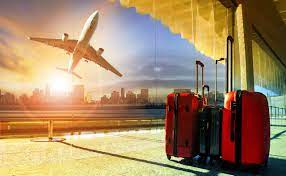

In [ ]:
bar_category(tourism_data, 'month', 'Entrances', 'year', 'Number entrances according to month')

In [ ]:
bar_category(group, 'month', 'new_cases', 'year', 'Number new cases according to month')

## **Employment**

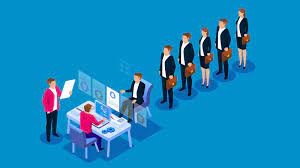

In [ ]:
bar_category(employment_data, 'month', 'employed(1000)', 'year', 'Number employed according to month')

In [ ]:
g = sns.lineplot(employment_data['month'], employment_data['Rate of change (previous month)'], hue=employment_data['year'])
g.set_title("Rate of change (previous month)")
sns.set(rc={'figure.figsize':(25, 10)})
plt.figure()

In [ ]:
plt.clf()
g = sns.lineplot(employment_data['month'], employment_data['Rate of change (previous year)'], hue=employment_data['year'])
g.set_title("Rate of change (previous year)")
sns.set(rc={'figure.figsize':(25, 10)})
plt.figure()

## **News**

In [ ]:
u = "https://www.deutschland.de/de/news/coronavirus-in-deutschland-informationen"
s = requests.get(u).content.decode('utf-8')

soup = BeautifulSoup(s, 'html.parser')
data = soup.findAll(['h2'])
dates = []
for i in data:
  try:
    dates.append(datetime.strptime(str(i).split(":")[0][-10:], '%d.%m.%Y').strftime('%d/%m/%Y'))
  except:
    pass

In [ ]:
 owid_data_ger['date']

In [ ]:
colors = []
for i in owid_data_ger['date']:
  if str(i) in dates:
    colors.append("hotpink")
  else:
    colors.append("#88c999")
plt.scatter(owid_data_ger['date'], owid_data_ger['new_cases'], color=colors)
plt.show()

In [ ]:
soup = BeautifulSoup(s, 'html.parser')
p_ = soup.findAll('p')

r = re.compile(r"<p><span><span><span><span><span>.*</span></span></span></span></span></p>")

words = []
for section in p_:
    found = r.findall(str(section))
    if found != []:
      parser = found[0].split('<p><span><span><span><span><span>')[1].split('</span></span></span></span></span></p>')[0]
      if ">" not in parser:
        for i in parser.split(" "):
            words.append(i)
words = " ".join(map(str,words ))

In [ ]:
stopwords_ = stopwords.words('german')
print(stopwords_)
wordcloud = WordCloud(width = 800, height = 800, 
                background_color ='black', 
                stopwords = stopwords_, 
                 collocations=False,
                min_font_size = 10)

# using the subject frquencies
# wordcloud.fit_words(frequencies=counts)
wordcloud.generate(words)
plt.figure(figsize = (20, 20), facecolor = None) 
plt.imshow(wordcloud)

## **tweepy - Publications affect vaccines**

In [ ]:
# auth = OAuthHandler(api_key, api_secret_key)
# auth.set_access_token(access_token, access_token_secret)

# api = tweepy.API(auth)

# tweets = api.user_timeline(screen_name="BMG_Bund", count=10000, lang="ger", tweet_mode="extended")
# # for tweet in tweets:
# #     print(f"- {tweet.full_text}")



# df = pd.DataFrame([(tweet.full_text, tweet.created_at.strftime('%Y/%m/%Y')) for tweet in tweets], columns=["tweet", "date"])
# df.to_csv("tweets.csv")

df = pd.read_csv(os.path.join('drive', 'MyDrive', 'Exam_COVID', 'Data', "tweets.csv"))
# Clean The Data
def cleantext(text):
    text = re.sub(r"@[A-Za-z0-9]+", "", text)  # Remove Mentions
    text = re.sub(r"#", "", text)  # Remove Hashtags Symbol
    text = re.sub(r"RT[\s]+", "", text)  # Remove Retweets
    text = re.sub(r"https?:\/\/\S+", "", text)  # Remove The Hyper Link
    return text

# Clean The Text
df["tweet"] = df["tweet"].apply(cleantext)
df.head()



# Get The Subjectivity
def sentiment_analysis(ds):
    sentiment = TextBlob(ds["tweet"]).sentiment
    return pd.Series([sentiment.subjectivity, sentiment.polarity])


# Adding Subjectivity & Polarity
df[["subjectivity", "polarity"]] = df.apply(sentiment_analysis, axis=1)


# Compute The Negative, Neutral, Positive Analysis
def analysis(score):
    if score < 0:
        return "Negative"
    elif score == 0:
        return "Neutral"
    else:
        return "Positive"
# Create a New Analysis Column
df["analysis"] = df["polarity"].apply(analysis)

positive_tweets = df[df['analysis'] == 'Positive']
negative_tweets = df[df['analysis'] == 'Negative']

In [ ]:
str(datetime.strptime(row['date'], '%d/%m/%Y').strftime('%Y/%m/%d'))

In [ ]:
df['date'].values.astype(str)

In [ ]:
list_analysis = []
for index, row in owid_data_ger.iterrows():
  if str(datetime.strptime(row['date'], '%d/%m/%Y').strftime('%Y/%m/%d')) in df['date'].values.astype(str):
      values = df[df['date']==datetime.strptime(row['date'], '%d/%m/%Y').strftime('%Y/%m/%d')]['analysis']
      values = [i for i in list(values) if i == 'Positive' or i == 'Negative']
      list_analysis.append(values)
  # else:
  #   list_analysis.append("None")


In [ ]:
list_analysis

# **Q2**

## **Create newtwork**

In [ ]:
!mkdir /root/.kaggle/
import json
import os
!pip install kaggle 
# api_token = {"username":"XXX","key":"XX"}
with open('/root/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)
!chmod 600 /root/.kaggle/kaggle.json


In [ ]:
!mkdir ./datasets
!mkdir ./datasets/meta-kaggle
# download the dataset from Kaggle and unzip it
!kaggle datasets download kaggle/meta-kaggle -p ./datasets/meta-kaggle/
!unzip ./datasets/meta-kaggle/*.zip  -d ./datasets/meta-kaggle
!ls ./datasets/meta-kaggle

100% 4.52G/4.52G [01:25<00:00, 47.5MB/s]
100% 4.52G/4.52G [01:25<00:00, 56.8MB/s]
Archive:  ./datasets/meta-kaggle/meta-kaggle.zip
  inflating: ./datasets/meta-kaggle/CompetitionTags.csv  
  inflating: ./datasets/meta-kaggle/Competitions.csv  
  inflating: ./datasets/meta-kaggle/DatasetTags.csv  
  inflating: ./datasets/meta-kaggle/DatasetTaskSubmissions.csv  
  inflating: ./datasets/meta-kaggle/DatasetTasks.csv  
  inflating: ./datasets/meta-kaggle/DatasetVersions.csv  
  inflating: ./datasets/meta-kaggle/DatasetVotes.csv  
  inflating: ./datasets/meta-kaggle/Datasets.csv  
  inflating: ./datasets/meta-kaggle/Datasources.csv  
  inflating: ./datasets/meta-kaggle/EpisodeAgents.csv  
  inflating: ./datasets/meta-kaggle/Episodes.csv  
  inflating: ./datasets/meta-kaggle/ForumMessageVotes.csv  
  inflating: ./datasets/meta-kaggle/ForumMessages.csv  
  inflating: ./datasets/meta-kaggle/ForumTopics.csv  
  inflating: ./datasets/meta-kaggle/Forums.csv  
  inflating: ./datasets/meta-kaggle/Ke

In [ ]:
sf_TM = tc.SFrame.read_csv("./datasets/meta-kaggle/TeamMemberships.csv")

Finished parsing file /content/datasets/meta-kaggle/TeamMemberships.csv

Parsing completed. Parsed 100 lines in 3.48474 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[int,int,int,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Read 1243254 lines. Lines per second: 324518

Read 3636922 lines. Lines per second: 401895

Finished parsing file /content/datasets/meta-kaggle/TeamMemberships.csv

Parsing completed. Parsed 4980215 lines in 9.55851 secs.

In [ ]:
sf_TM.show

<bound method SFrame.show of Columns:
	Id	int
	TeamId	int
	UserId	int
	RequestDate	str

Rows: 4980215

Data:
+-------+--------+--------+-------------+
|   Id  | TeamId | UserId | RequestDate |
+-------+--------+--------+-------------+
| 16458 |  518   |  635   |             |
| 16464 |  526   |  839   |             |
| 16465 |  527   |  816   |             |
| 16466 |  528   |  778   |             |
| 16467 |  529   |  747   |             |
| 16468 |  531   |  842   |             |
| 16469 |  532   |  820   |             |
| 16470 |  532   |  879   |             |
| 16471 |  533   |  819   |             |
| 16472 |  533   |  821   |             |
+-------+--------+--------+-------------+
[4980215 rows x 4 columns]
Note: Only the head of the SFrame is printed.
You can use print_rows(num_rows=m, num_columns=n) to print more rows and columns.>

In [ ]:
sf_TM.show()

Materializing SFrame

In [ ]:
sf_TM = sf_TM.remove_column('RequestDate')

In [ ]:
g_teamID = sf_TM.groupby(['TeamId'], {'Count': agg.COUNT()})
g_teamID

TeamId,Count
922661,1
6824453,1
6120761,1
7236244,1
7089743,1
7887308,1
4565672,1
6102746,1
5023327,1
6197508,3


In [ ]:
g_teamID = g_teamID[g_teamID['Count'] >  2]
sf_TM = sf_TM.filter_by(list(g_teamID['TeamId']), "TeamId")
sf_TM.show

/usr/local/lib/python3.7/dist-packages/turicreate/data_structures/sarray.py:473: DeprecationWarning:

Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working



<bound method SFrame.show of Columns:
	Id	int
	TeamId	int
	UserId	int

Rows: 119974

Data:
+-------+--------+--------+
|   Id  | TeamId | UserId |
+-------+--------+--------+
| 16580 |  700   |  1136  |
| 16581 |  700   |  1138  |
| 16582 |  700   |  1215  |
| 16583 |  700   |  1332  |
| 16618 |  754   |  752   |
| 16619 |  754   |  1434  |
| 16620 |  754   |  1613  |
| 28308 | 12966  | 31359  |
| 28309 | 12966  | 32039  |
| 28310 | 12966  | 31354  |
+-------+--------+--------+
[119974 rows x 3 columns]
Note: Only the head of the SFrame is printed.
You can use print_rows(num_rows=m, num_columns=n) to print more rows and columns.>

In [ ]:
user_edges = {u: [] for u in sf_TM['UserId']}

Create edges

In [ ]:
df_TM = sf_TM.to_dataframe()

In [ ]:
for team_id, df in df_TM.groupby(['TeamId']):
  for a, b in itertools.combinations(df.UserId.values, 2):
      user_edges[a].append(b)
      user_edges[b].append(a)

In [ ]:
g = nx.Graph() # Creating Undirected Graph
# adding each node and edge one after the other
for n in user_edges:
    g.add_node(n)

for r in user_edges:
    for i in user_edges[r]:
      g.add_edge(r, i)

In [ ]:
print(nx.info(g))

Graph with 84616 nodes and 146230 edges


In [ ]:
d = g.degree()

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/pytho

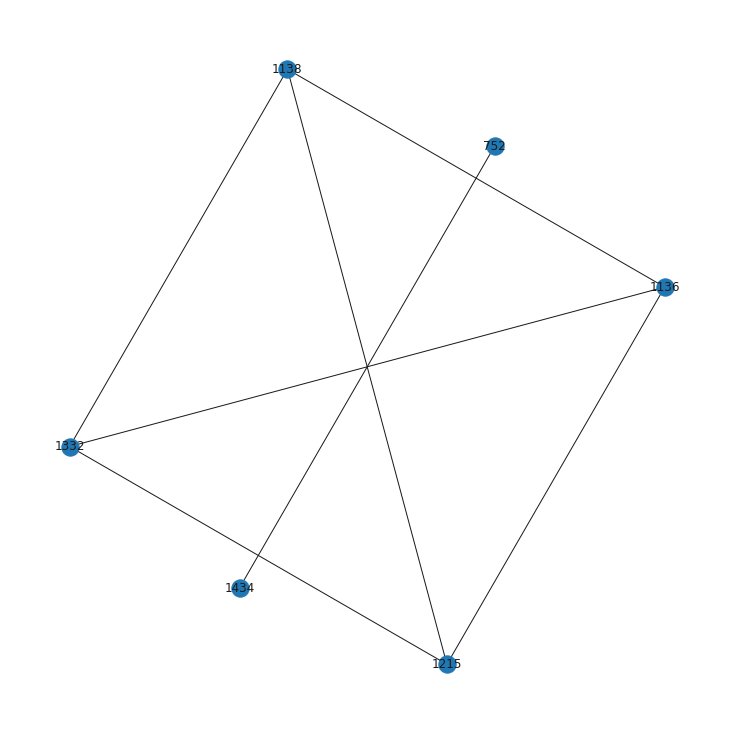

In [ ]:
selected_nodes_list = [n for n,d in list(dict(d).items())[:6] if d > 1]
# create a subgraph with only nodes from the above list
h = g.subgraph(selected_nodes_list)
plt.figure(figsize=(10, 10))
nx.draw_kamada_kawai(h, with_labels=True)

Let's find the vertex with the highest degree:

In [ ]:
max(dict(d).items(), key=operator.itemgetter(1))

(54836, 114)

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/pytho

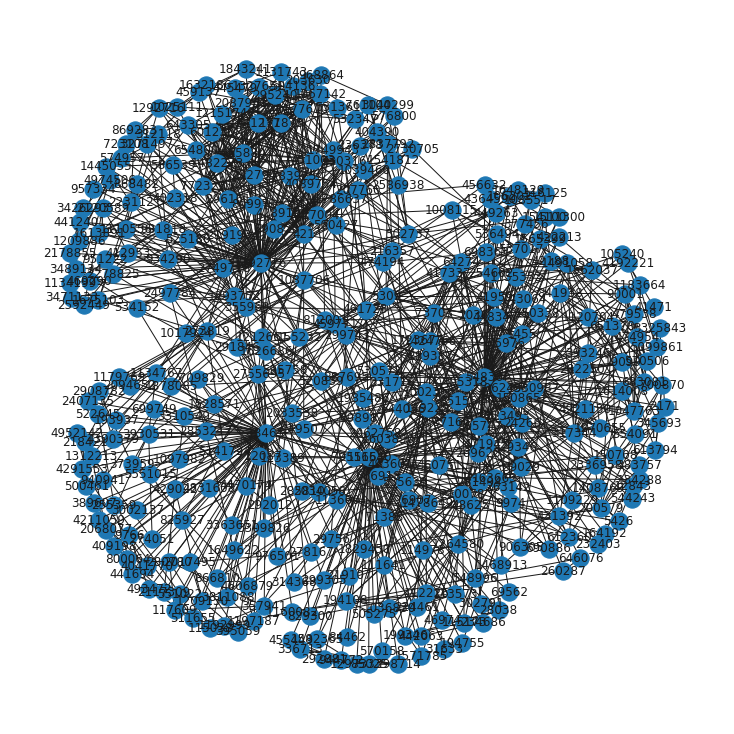

In [ ]:
selected_nodes_list = [n for n,d in dict(d).items() if d > 80]
selected_nodes_list = [  j for i in selected_nodes_list for j  in user_edges[i]]
h = g.subgraph(selected_nodes_list)
plt.figure(figsize=(10, 10))
nx.draw_kamada_kawai(h, with_labels=True)

Text(0, 0.5, 'degree')

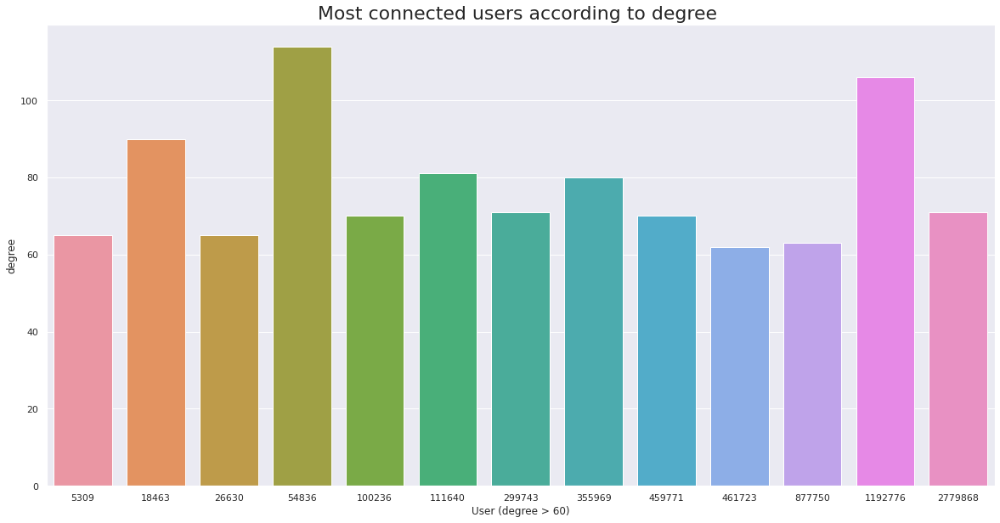

In [ ]:
selected_nodes_list = [n for n,d in dict(d).items() if d > 60]
plt.figure(figsize=(20,10))
ax = sns.barplot(x=selected_nodes_list, y=[dict(d)[i] for i in dict(d) if i in selected_nodes_list])
sns.set_theme(style="whitegrid")
ax.set_title("Most connected users according to degree ", fontsize=22)
ax.set_xlabel("User (degree > 60)")
ax.set_ylabel("degree")

In [ ]:
# plt.figure(figsize=(20,20))
# nx.draw_circular(selected_nodes_list, with_labels=True)

So, using the degree, we discovered that the "most friendly" superhero is 54836 who is connected to 114 group. 

Let's use seaborn to calculate the graph degree distribution:

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



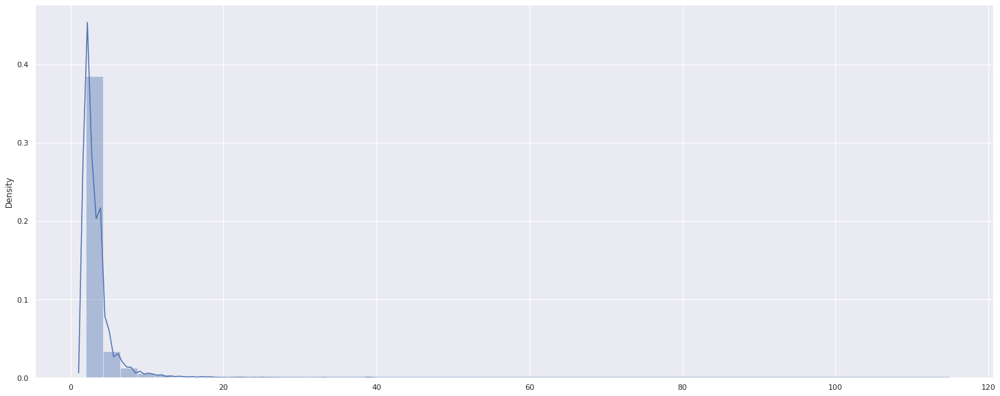

In [ ]:
sns.set()
sns.distplot([v for v in dict(d).values()])

In [ ]:
d = nx.pagerank(g)
max(dict(d).items(), key=operator.itemgetter(1))   

/usr/local/lib/python3.7/dist-packages/networkx/algorithms/link_analysis/pagerank_alg.py:108: DeprecationWarning:

networkx.pagerank_scipy is deprecated and will be removed in NetworkX 3.0, use networkx.pagerank instead.



(54836, 0.0001288471414991478)

In [ ]:
#According to Closeness Centrality who is the most central hero:
d = nx.closeness_centrality(g) # can take some time to run
max(dict(d).items(), key=operator.itemgetter(1))

(54836, 0.02927856389484446)

## **Find communities**

In [ ]:
d = g.degree()
# let's create a list with nodes that have degree > 1
selected_nodes_list = [n for n,d in dict(d).items() if d > 1]
# create a subgraph with only nodes from the above list
h = g.subgraph(selected_nodes_list)
print(nx.info(h))

Graph with 84616 nodes and 146230 edges


Let's use Clauset-Newman-Moore greedy modularity maximization to separate the graph into communities, and answer the following question:

In [ ]:
from networkx.algorithms.community import greedy_modularity_communities
cc = greedy_modularity_communities(h) # this can take some time

In [ ]:
len(cc)

18721

Text(0.5, 0, 'Number user')

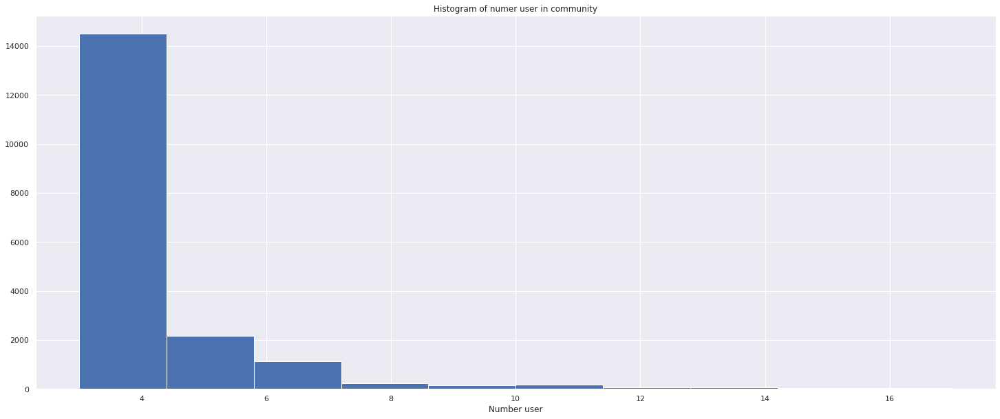

In [ ]:
community_size_list = [len(c) for c in cc if len(c) < 18]
plt.hist(community_size_list)
plt.title('Histogram of numer user in community')
plt.xlabel('Number user')

Find the biggest community

In [ ]:
largest_community = max(cc, key=len)
len(largest_community)

6638

In [ ]:
54836  in largest_community

True

In [ ]:
selected_community_list = [c for c in cc if 500 > len(c) > 100]
len(selected_community_list)

3

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/pytho

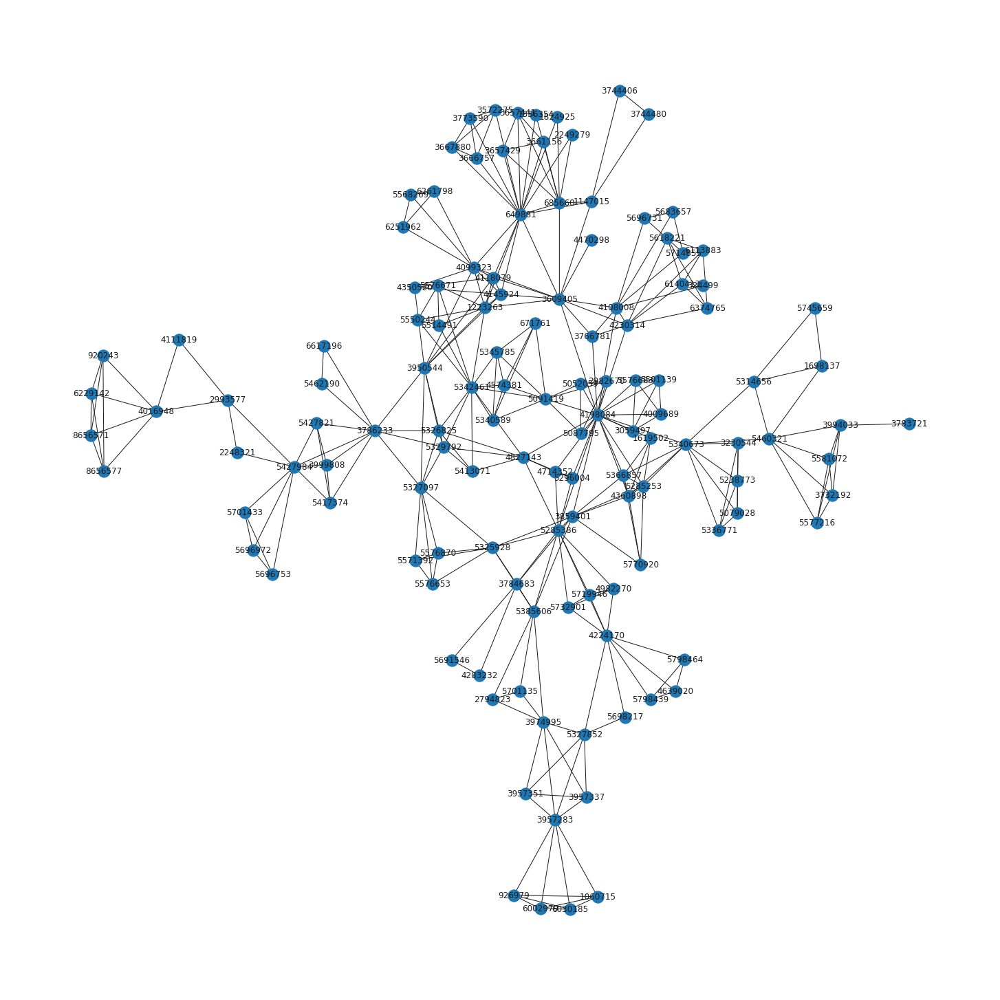

In [ ]:
plt.figure(figsize=(20,20))
c1 = h.subgraph(selected_community_list[0])
nx.draw_kamada_kawai(c1, with_labels=True)

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/pytho

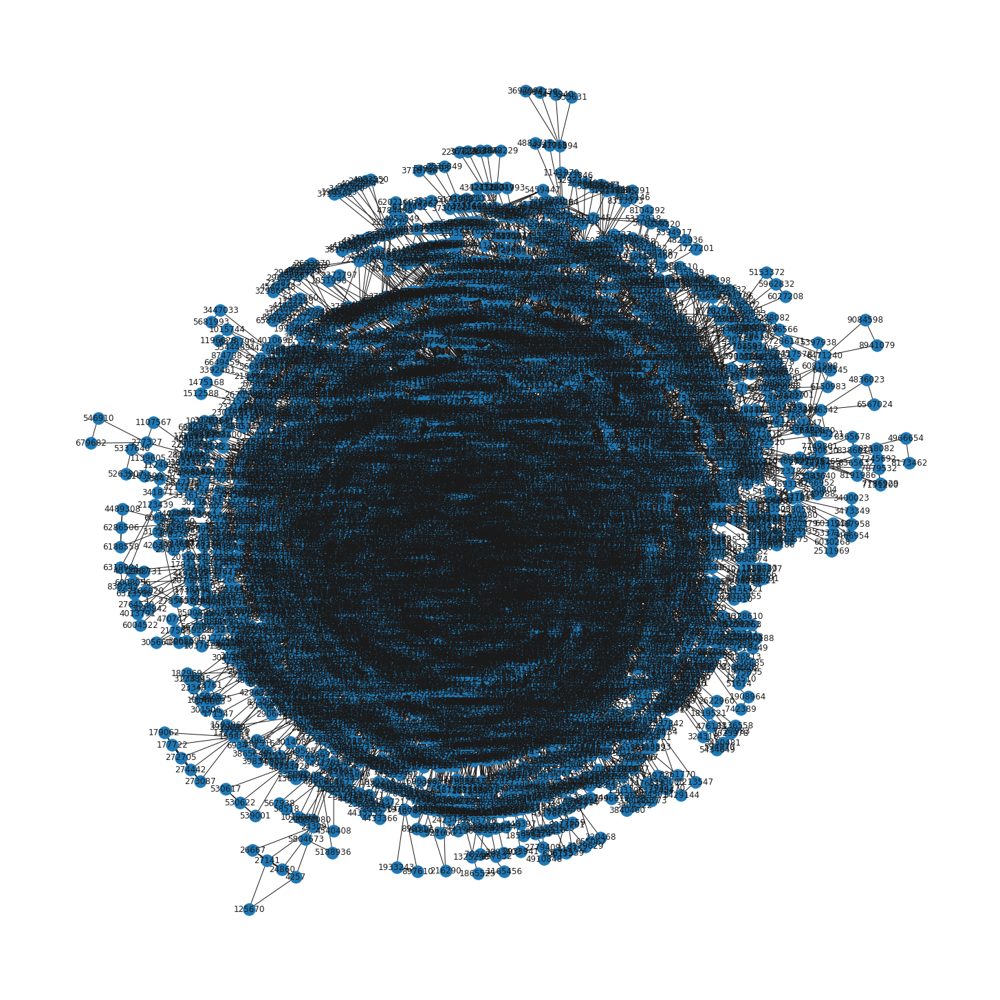

In [ ]:
plt.figure(figsize=(20,20))
c1 = h.subgraph(largest_community)
nx.draw_kamada_kawai(c1, with_labels=True)

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning:

tostring() is deprecated. Use tobytes() instead.

/usr/local/lib/pytho

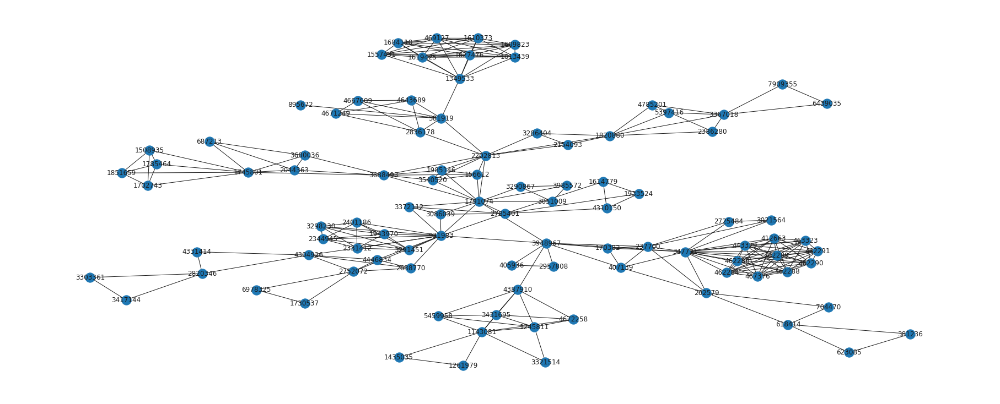

In [ ]:
communities_list = [c for c in cc if 100 > len(c) > 50]
communities_list_graph = g.subgraph(communities_list[0])
nx.draw_kamada_kawai(communities_list_graph, with_labels=True)
json_file = nx.cytoscape_data(communities_list_graph)
nx.write_gexf(communities_list_graph, './datasets/meta-kaggle/network.gexf', version="1.2draft")

## **10 Competitions**

In [ ]:
df_Team = pd.read_csv("./datasets/meta-kaggle/TeamMemberships.csv")
g = df_Team.groupby('TeamId', as_index=False).agg(list)
g

,TeamId,Id,UserId,RequestDate
0,496,[16436],[647],[nan]
1,497,[16437],[619],[nan]
2,499,[16438],[663],[nan]
3,500,[16439],[673],[nan]
4,501,[16440],[435],[nan]
...,...,...,...,...
4842740,8065244,[8302264],[9507171],[01/27/2022]
4842741,8065247,[8302267],[6369655],[01/27/2022]
4842742,8065248,[8302268],[9499665],[01/27/2022]
4842743,8065249,[8302269],[2208062],[01/27/2022]


In [ ]:
groups = [i for i in g['UserId']]

In [ ]:
groups_3 = []
for i in g['UserId'].values:
  i = [ j for j in i if str(j) != 'nan']
  i = list( dict.fromkeys(i) )
  if len(i) >= 3:
    groups_3.append([j for j in sorted(i)])

In [ ]:
len(g['UserId'].values)

4842745

In [ ]:
len(groups_3)

32607

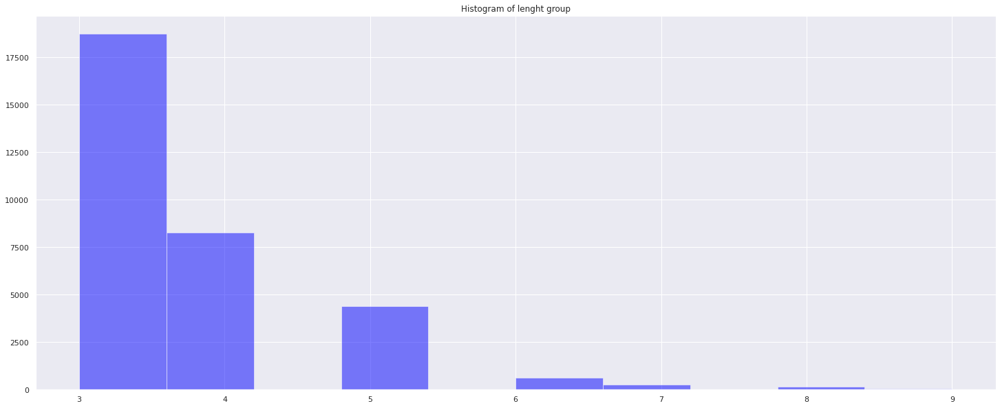

In [ ]:
plt.hist([len(i) for i in groups_3 if len(i) < 10], facecolor='blue', alpha=0.5)
plt.title("Histogram of lenght group")
plt.show()

In [ ]:
group_5 = [i for i in groups_3 if len(i) < 5]

In [ ]:
len(group_5)

27019

In [ ]:
import itertools
groups_3_subset = []
for group  in group_5:
  for subset in itertools.combinations(group, 3):
        groups_3_subset.append(subset)

In [ ]:
len(groups_3_subset)

51790

In [ ]:
df_groups_3_subset = pd.DataFrame(groups_3_subset)

In [ ]:
duplicate = df_groups_3_subset[df_groups_3_subset.duplicated(keep = 'last')]

In [ ]:
size = df_groups_3_subset.groupby(df_groups_3_subset.columns.tolist(),as_index=False).size()

In [ ]:
size[size['size']>=10]

In [ ]:
sum_group = []
for i in group_5:
  if 1421155  in i and 1460130	 in i and	2290703	in i:
      sum_group.append(i)

In [ ]:
dict_CompetitionId = set()
for index, row  in g.iterrows():
  if 1421155  in row['UserId'] and 1460130 in row['UserId'] and 2290703 in row['UserId']:
      dict_CompetitionId.add(row['TeamId'])

In [ ]:
test = df_Team[df_Team['TeamId'].isin(list(dict_CompetitionId))]

In [ ]:
g1 = test.groupby('TeamId', as_index=False).agg(list)
g1

In [ ]:
for i in g1['UserId']:
  if 1421155  in i and 1460130 in i and 2290703 in i:
    print(i)

## **ForumMessages**

In [ ]:
topics = pd.read_csv('./datasets/meta-kaggle/ForumTopics.csv').rename(columns={'Title': 'TopicTitle'})
forums = pd.read_csv('./datasets/meta-kaggle/Forums.csv').rename(columns={'Title': 'ForumTitle'})
forum_posts = pd.read_csv("./datasets/meta-kaggle/ForumMessages.csv")

In [ ]:
df1 = pd.merge(forum_posts[['ForumTopicId', 'PostDate', 'Message']], topics[['Id', 'ForumId', 'TopicTitle']], left_on='ForumTopicId', right_on='Id')
df1 = df1.drop(['ForumTopicId', 'Id'], axis=1)

forum_posts = pd.merge(df1, forums[['Id', 'ForumTitle']], left_on='ForumId', right_on='Id')
forum_posts = forum_posts.drop(['ForumId', 'Id'], axis=1)
forum_posts.head(20)

,PostDate,Message,TopicTitle,ForumTitle
0,05/12/2010 04:39:30,Here are some papers that analyze Eurovision v...,Studies that look at Eurovision voting patterns,Forecast Eurovision Voting
1,05/12/2010 04:39:30,More research... enjoy<br><br>Love thy Neighbo...,Studies that look at Eurovision voting patterns,Forecast Eurovision Voting
2,05/12/2010 08:34:27,There's also this piece from the BBC on the <a...,The maths of Eurovision voting,Forecast Eurovision Voting
3,12/01/2010 21:46:53,Is there a time order between the training and...,Time order?,IJCNN Social Network Challenge
4,12/01/2010 21:46:53,No the whole network was sampled within a few ...,Time order?,IJCNN Social Network Challenge
5,12/01/2010 05:54:28,After I specify the adress of my result file a...,Why cannot submit my result?,IJCNN Social Network Challenge
6,12/01/2010 05:54:28,This looks fine to me. Do you have funny line ...,Why cannot submit my result?,IJCNN Social Network Challenge
7,12/01/2010 05:54:28,You can email me the file if you like anthony....,Why cannot submit my result?,IJCNN Social Network Challenge
8,04/19/2011 15:10:59,<p>Сan I use the description of the Social net...,Сan I use the description of this problem?,IJCNN Social Network Challenge
9,05/07/2011 18:50:43,<p>(Sorry about the slow response)</p>\r\n<p>R...,Сan I use the description of this problem?,IJCNN Social Network Challenge


In [ ]:
forum_posts['PostDate' + "_split"] = forum_posts['PostDate'].apply(lambda x: x.split("/"))
forum_posts['year'] = forum_posts['PostDate' + "_split"].apply(lambda x:  int(x[2].split(" ")[0]))

In [ ]:
forum_posts.pop('PostDate' + "_split")

0          [05, 12, 2010 04:39:30]
1          [05, 12, 2010 04:39:30]
2          [05, 12, 2010 08:34:27]
3          [12, 01, 2010 21:46:53]
4          [12, 01, 2010 21:46:53]
                    ...           
1410195    [01, 20, 2022 17:08:59]
1410196    [01, 09, 2022 15:20:17]
1410197    [01, 17, 2022 00:20:46]
1410198    [01, 18, 2022 10:34:49]
1410199    [01, 21, 2022 07:04:54]
Name: PostDate_split, Length: 1410200, dtype: object

In [ ]:
stop_words_set = set(stopwords.words("english"))
stemmer = PorterStemmer()

#Using cahcing for faster performence
@lru_cache(maxsize=None)
def word_stemming(w):
    return stemmer.stem(w)


def skip_word(w):
    if len(w) <2:
        return True
    if w.isdigit():
        return True
    if w.isdigit():
        return True
    if not w.isalpha():
      if "++" not in w:
        return True
    if w in stop_words_set or stemmer.stem(w) in stop_words_set:
        return True
    return False

def text_to_bow(text):
    text = text.lower()
    l = [word_stemming(w) for w in word_tokenize(text) if not skip_word(w) ]
    l = [w for w in l if not skip_word(w)]
    return l 

In [ ]:
nltk.download('punkt')
dict_ = {}
for i in forum_posts.groupby('year'):
  bow_list = []
  for t in i[1]['Message'].astype(str)[:100000]:
    bow_list.extend(text_to_bow(t))
  dict_[i[0]] = bow_list

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:
counter_ = {}
for i in dict_:
  counter_[i] = Counter(dict_[i])
counter_[2010]

Counter({'paper': 66,
         'analyz': 7,
         'eurovis': 10,
         'vote': 9,
         'pattern': 9,
         'might': 118,
         'find': 137,
         'help': 114,
         'br': 11264,
         'gather': 3,
         'comparison': 19,
         'song': 6,
         'contest': 335,
         'simul': 11,
         'actual': 178,
         'result': 674,
         'reveal': 20,
         'shift': 4,
         'collus': 1,
         'allianc': 1,
         'http': 527,
         'polit': 2,
         'cultur': 2,
         'ginburgh': 1,
         'nouri': 1,
         'fenn': 1,
         'suleman': 1,
         'efstathi': 1,
         'johnson': 1,
         'friendship': 2,
         'network': 59,
         'dekker': 1,
         'research': 32,
         'enjoy': 6,
         'love': 19,
         'thi': 2,
         'neighbor': 3,
         'kin': 1,
         'bias': 15,
         'geographi': 1,
         'religion': 1,
         'explain': 38,
         'bia': 26,
         'hybrid': 2,
         '

In [ ]:
!pip install pandas==1.3.1

  Using cached pandas-1.3.1-cp37-cp37m-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (11.5 MB)
  Attempting uninstall: pandas
    Found existing installation: pandas 1.3.5
    Uninstalling pandas-1.3.5:
      Successfully uninstalled pandas-1.3.5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires pandas~=1.1.0; python_version >= "3.0", but you have pandas 1.3.1 which is incompatible.


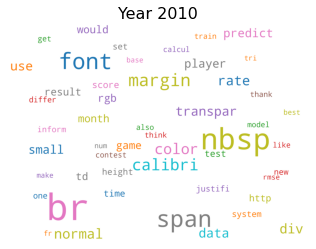

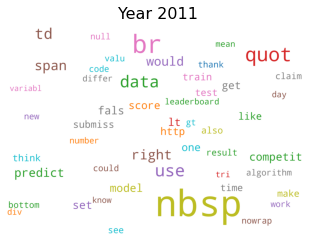

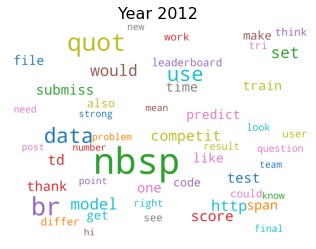

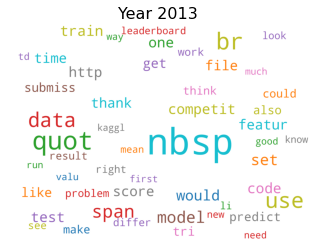

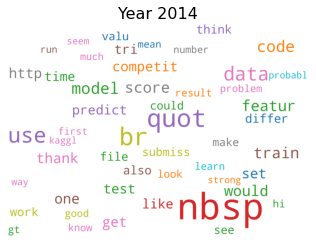

...

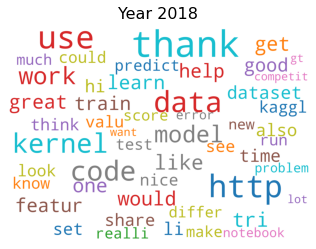

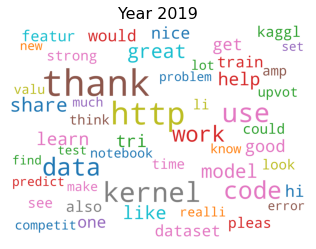

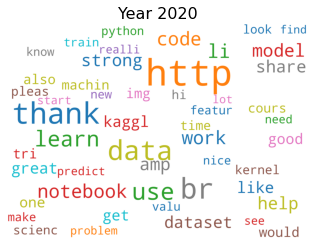

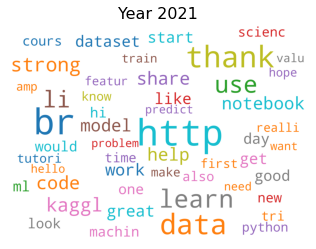

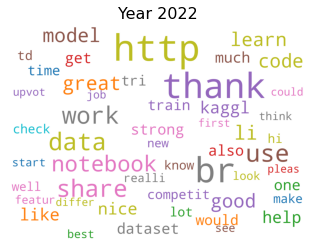

In [ ]:
# 1
for year in counter_:
  cloud = WordCloud(background_color='white',
                    width=2500,
                    height=1800,
                    max_words=50,
                    colormap='tab10',
                    prefer_horizontal=1.0)
  cloud.generate_from_frequencies(counter_[year], max_font_size=300)
  plt.gca().imshow(cloud)
  plt.gca().set_title('Year ' + str(year), fontdict=dict(size=16))
  plt.gca().axis('off')
  plt.show()

In [ ]:
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis


dict_topic_model = {}
for i in counter_:
  docs = tc.text_analytics.count_words(tc.SArray(dict_[i]))
  docs = docs.apply(lambda d: {w:v for w, v in d.items()})
  topic_model = tc.topic_model.create(docs, num_topics=50)
  # topic_model.get_topics().print_rows(100)
  dict_topic_model[i] = topic_model
  id2word = corpora.Dictionary(docs)
  corpus = [id2word.doc2bow(text) for text in docs]
  lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=50, 
                                           update_every=0,
                                           chunksize=500,
                                           alpha='auto',
                                           per_word_topics=True)

  pyLDAvis.enable_notebook()
  vis = gensimvis.prepare(lda_model, corpus, id2word)
vis

/usr/local/lib/python3.7/dist-packages/turicreate/data_structures/sarray.py:473: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  elif isinstance(data, collections.Sequence):


Learning a topic model

Number of documents    115645

Vocabulary size      4516

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 557.459ms     | 2.4565e+06     | 0               |

+-----------+---------------+----------------+-----------------+

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt

Learning a topic model

Number of documents    301057

Vocabulary size      9505

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 1.42s         | 2.45351e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt

Learning a topic model

Number of documents    333378

Vocabulary size     10632

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 1.67s         | 2.21389e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt

Learning a topic model

Number of documents    541910

Vocabulary size     13210

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 2.52s         | 2.48942e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt

Learning a topic model

Number of documents    628367

Vocabulary size     13993

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 2.92s         | 2.47249e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt

Learning a topic model

Number of documents   1059896

Vocabulary size     18955

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 4.93s         | 2.47795e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt

Learning a topic model

Number of documents   1377689

Vocabulary size     24493

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 8.17s         | 2.39944e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt

Learning a topic model

Number of documents   2047863

Vocabulary size     35941

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 9.87s         | 2.3323e+06     | 0               |

+-----------+---------------+----------------+-----------------+

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt

Learning a topic model

Number of documents   1631600

Vocabulary size     33121

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 7.56s         | 2.42192e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt

Learning a topic model

Number of documents   1350151

Vocabulary size     33070

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 6.50s         | 2.33073e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt

Learning a topic model

Number of documents   1830665

Vocabulary size     33518

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 8.63s         | 2.38893e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt

Learning a topic model

Number of documents   1789063

Vocabulary size     30203

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 8.38s         | 2.41306e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt

Learning a topic model

Number of documents    331885

Vocabulary size     12514

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 2.09s         | 2.19606e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
27    -0.329923 -0.066593       1        1  99.858575
43    -0.166798  0.166608       2        1   0.005001
14    -0.075604 -0.025964       3        1   0.003712
11    -0.063131 -0.072635       4        1   0.003487
18    -0.044344 -0.046003       5        1   0.003361
28    -0.025824 -0.081185       6        1   0.003301
36    -0.021184  0.048050       7        1   0.003123
38    -0.022520  0.052630       8        1   0.003061
31    -0.007404  0.045843       9        1   0.003005
0      0.005169 -0.028612      10        1   0.002991
40    -0.018098  0.036308      11        1   0.002974
39     0.001336 -0.050772      12        1   0.002959
4     -0.005613  0.009055      13        1   0.002921
20    -0.003563  0.061201      14        1   0.002894
42     0.006997 -0.030333      15        1   0.002879
35    -0.000768  0.003083      16        1   0.002868
6      0.000627 -0.004818      17        1   0.002859
19     0.020639 -0.016349      18        1   0.002853
23     0.002308 -0.016148      19        1   0.002841
46     0.005296 -0.022639      20        1   0.002835
48    -0.009339  0.029129      21        1   0.002827
29     0.024880 -0.016271      22        1   0.002823
3      0.020278 -0.001792      23        1   0.002820
49     0.012651  0.015742      24        1   0.002815
1      0.015884  0.002024      25        1   0.002806
32     0.011359 -0.019053      26        1   0.002802
10     0.023081 -0.007646      27        1   0.002776
2      0.012391 -0.014588      28        1   0.002769
45     0.017595 -0.003980      29        1   0.002766
24     0.013569 -0.008655      30        1   0.002765
44     0.022345  0.005412      31        1   0.002753
7      0.014316  0.025907      32        1   0.002728
37     0.038410 -0.007367      33        1   0.002722
21     0.031700 -0.015765      34        1   0.002714
33     0.035828 -0.004304      35        1   0.002712
25     0.016354  0.001349      36        1   0.002709
34     0.029386 -0.001937      37        1   0.002707
41     0.028799 -0.004180      38        1   0.002707
26     0.013520  0.029223      39        1   0.002694
12     0.027803  0.005999      40        1   0.002690
8      0.036152 -0.004814      41        1   0.002687
22     0.016281 -0.010371      42        1   0.002685
47     0.037788 -0.000097      43        1   0.002670
16     0.020736  0.035472      44        1   0.002667
17     0.036184 -0.012709      45        1   0.002651
15     0.033771  0.006483      46        1   0.002645
13     0.044813  0.011791      47        1   0.002626
30     0.038648  0.002958      48        1   0.002615
5      0.042162 -0.003512      49        1   0.002590
9      0.035061  0.004828      50        1   0.002561, topic_info=        Term          Freq         Total Category  logprob  loglift
0       http  11878.000000  11878.000000  Default  30.0000  30.0000
29        br  10688.000000  10688.000000  Default  29.0000  29.0000
38     thank  10801.000000  10801.000000  Default  28.0000  28.0000
96      data   4206.000000   4206.000000  Default  27.0000  27.0000
70       use   4373.000000   4373.000000  Default  26.0000  26.0000
..       ...           ...           ...      ...      ...      ...
323   reason      0.030173    264.574887  Topic50  -5.6407   1.4938
0       http      0.118918  11878.178308  Topic50  -4.2692  -0.9391
55      post      0.030173    620.692536  Topic50  -5.6407   0.6411
1        hey      0.000592    274.754598  Topic50  -9.5725  -2.4758
2    everyon      0.000592    229.315480  Topic50  -9.5725  -2.2950

[3583 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
1342      1  0.984957  abhishek
291       1  1.001805      abil
544       1  0.999705       abl
218       1  0.982098    academ
312       1  0.983866   acceler
...     ...       ...       ...
489       1  0.972278       xml
341    

In [ ]:
topics_ = {}
for i in dict_topic_model:
  print(f" for year {i} the 10 topic {list(dict_topic_model[i].topics['vocabulary'][:10])}")
  topics_[i] = dict_topic_model[i].topics['vocabulary']

 for year 2010 the 10 topic ['paper', 'analyz', 'eurovis', 'vote', 'pattern', 'might', 'find', 'help', 'br', 'gather']
 for year 2011 the 10 topic ['сan', 'use', 'descript', 'social', 'network', 'challeng', 'problem', 'refer', 'site', 'scientif']
 for year 2012 the 10 topic ['agre', 'would', 'use', 'well', 'good', 'allow', 'algorithm', 'expos', 'ridicul', 'valu']
 for year 2013 the 10 topic ['div', 'exampl', 'ami', 'myocardi', 'infarct', 'follow', 'combin', 'queri', 'group', 'nbsp']
 for year 2014 the 10 topic ['hi', 'possibl', 'get', 'access', 'train', 'data', 'competit', 'agre', 'compet', 'end']
 for year 2015 the 10 topic ['http', 'link', 'document', 'much', 'appreci', 'someon', 'post', 'thank', 'anyon', 'nbsp']
 for year 2016 the 10 topic ['previou', 'particip', 'mayb', 'help', 'request', 'train', 'data', 'thank', 'cukierski', 'http']
 for year 2017 the 10 topic ['request', 'train', 'data', 'thank', 'clickm', 'interest', 'hy', 'problem', 'face', 'technolog']
 for year 2018 the 10 t

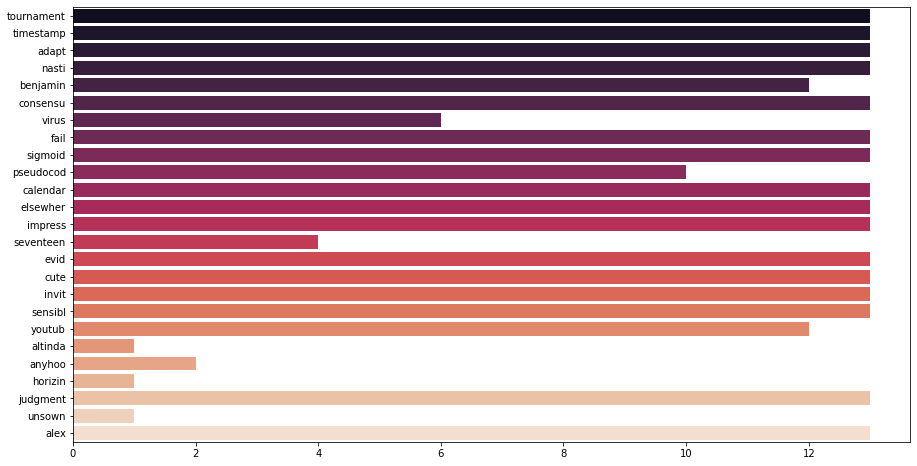

In [ ]:
plt.figure(figsize=(15,8))
sns.barplot(y=list(topic_all_years.keys())[:25], x=list(topic_all_years.values())[:25], palette="rocket")

In [ ]:
topic_all_years

{'tournament': 13,
 'timestamp': 13,
 'adapt': 13,
 'nasti': 13,
 'benjamin': 12,
 'consensu': 13,
 'virus': 6,
 'fail': 13,
 'sigmoid': 13,
 'pseudocod': 10,
 'calendar': 13,
 'elsewher': 13,
 'impress': 13,
 'seventeen': 4,
 'evid': 13,
 'cute': 13,
 'invit': 13,
 'sensibl': 13,
 'youtub': 12,
 'altinda': 1,
 'anyhoo': 2,
 'horizin': 1,
 'judgment': 13,
 'unsown': 1,
 'alex': 13,
 'meant': 13,
 'sizeabl': 12,
 'hunch': 13,
 'satisfi': 13,
 'iupac': 2,
 'turn': 13,
 'arimaa': 1,
 'note': 13,
 'mistak': 13,
 'ascertain': 9,
 'partit': 13,
 'regularli': 13,
 'jeff': 13,
 'merg': 13,
 'equival': 13,
 'argument': 13,
 'chunk': 13,
 'hit': 13,
 'thx': 13,
 'anthoni': 13,
 'radar': 11,
 'stake': 13,
 'foosbal': 2,
 'arbitrag': 9,
 'crazi': 13,
 'climb': 13,
 'announc': 13,
 'disclos': 13,
 'hmm': 13,
 'mitig': 13,
 'juri': 8,
 'larg': 13,
 'hot': 13,
 'em': 13,
 'xxxxxx': 5,
 'rather': 13,
 'trace': 13,
 'qrt': 1,
 'factori': 11,
 'human': 13,
 'applic': 13,
 'incident': 13,
 'stretch': 13,

In [ ]:
import spacy
from spacy import displacy
# !python -m spacy download en # Important! you need to restart runtime after install
nlp_ = spacy.load('en_core_web_sm')
for i in topics_:
  print(i)
  doc = nlp_(' '.join(list(topics_[i])))
  displacy.render(doc, style='ent', jupyter=True)

2010


2011


2012


2013


KeyboardInterrupt: ignored

In [ ]:
from nltk.tag import StanfordNERTagger
from nltk.tokenize import word_tokenize
!wget 'https://nlp.stanford.edu/software/stanford-ner-2018-10-16.zip'
!unzip stanford-ner-2018-10-16.zip
st = StanfordNERTagger('./stanford-ner-2018-10-16/classifiers/english.all.3class.distsim.crf.ser.gz',
'./stanford-ner-2018-10-16/stanford-ner.jar', encoding='utf-8')


In [ ]:
classified_text = st.tag(list(topics_[i]))

In [ ]:
import spacy
nlp = spacy.load('en_core_web_lg')

In [ ]:
entities_dict_year = {}
for year in topics_:
  doc = nlp(" ".join(list(topics_[year])))
  entities_dict = {}
  for entity in doc.ents:
        label = entity.label_
        val = entities_dict.get(label, 0)
        entities_dict[label] = val + 1
  entities_dict_year[year] =  entities_dict  

In [ ]:
df_entities_dict_year = pd.DataFrame(entities_dict_year)
df_entities_dict_year.T.head()
df_entities_dict_year = df_entities_dict_year.T

In [ ]:
df_entities_dict_year['Year'] = df_entities_dict_year.index

In [ ]:
df_entities_dict_year.head()

,NORP,PERSON,ORG,PERCENT,ORDINAL,CARDINAL,DATE,GPE,PRODUCT,TIME,LOC,WORK_OF_ART,FAC,EVENT,LAW,MONEY,QUANTITY,LANGUAGE,Year
2010,12.0,198.0,94.0,1.0,5.0,14.0,15.0,26.0,23.0,3.0,2.0,2.0,2.0,1.0,NaN,NaN,NaN,NaN,2010
2011,21.0,489.0,268.0,NaN,5.0,22.0,22.0,37.0,29.0,3.0,1.0,3.0,1.0,2.0,1.0,2.0,NaN,NaN,2011
2012,24.0,565.0,311.0,NaN,6.0,22.0,23.0,50.0,52.0,4.0,2.0,11.0,5.0,1.0,1.0,NaN,NaN,NaN,2012
2013,22.0,833.0,369.0,NaN,9.0,27.0,20.0,66.0,43.0,6.0,4.0,9.0,6.0,NaN,2.0,NaN,1.0,NaN,2013
2014,28.0,914.0,430.0,NaN,4.0,35.0,26.0,101.0,55.0,6.0,2.0,10.0,3.0,NaN,NaN,1.0,1.0,1.0,2014


In [ ]:
import plotly.graph_objects as go

import pandas as pd


years = [str(i) for i in list(df_entities_dict_year['Year'].values)]
dataset =df_entities_dict_year
# make list of continents
continents = []
for continent in list(df_entities_dict_year.columns)[1:-1]:
      continents.append(continent)
# make figure
fig_dict = {
    "data": [],
    "layout": {},
    "frames": []
}

# fill in most of layout
fig_dict["layout"]["xaxis"] = {"title": "Entities"}
fig_dict["layout"]["yaxis"] = {"title": "Count"}
fig_dict["layout"]["hovermode"] = "closest"
fig_dict["layout"]["updatemenus"] = [
    {
        "buttons": [
            {
                "args": [None, {"frame": {"duration": 500, "redraw": False},
                                "fromcurrent": True, "transition": {"duration": 300,
                                                                    "easing": "quadratic-in-out"}}],
                "label": "Play",
                "method": "animate"
            },
            {
                "args": [[None], {"frame": {"duration": 0, "redraw": False},
                                  "mode": "immediate",
                                  "transition": {"duration": 0}}],
                "label": "Pause",
                "method": "animate"
            }
        ],
        "direction": "left",
        "pad": {"r": 10, "t": 87},
        "showactive": False,
        "type": "buttons",
        "x": 0.1,
        "xanchor": "right",
        "y": 0,
        "yanchor": "top"
    }
]

sliders_dict = {
    "active": 0,
    "yanchor": "top",
    "xanchor": "left",
    "currentvalue": {
        "font": {"size": 20},
        "prefix": "Year:",
        "visible": True,
        "xanchor": "right"
    },
    "transition": {"duration": 300, "easing": "cubic-in-out"},
    "pad": {"b": 10, "t": 50},
    "len": 0.9,
    "x": 0.1,
    "y": 0,
    "steps": []
}

# make data
year = years[0]
for continent in continents:
  dataset_by_year = dataset[dataset["Year"] == int(year)]
  dataset_by_year_and_cont = dataset_by_year

  data_dict = {
      "x": list(df_entities_dict_year.columns)[1:-1],
      "y": list(dataset_by_year_and_cont.iloc[0])[2:-1],
      "mode": "markers",
      # "text": list(dataset_by_year_and_cont["country"]),
      "marker": {
          "sizemode": "area",
          "sizeref": 200000,
          # "size": list(dataset_by_year_and_cont["pop"])
      },
      "name": continent
  }
  fig_dict["data"].append(data_dict)

# make frames
for year in years:
    frame = {"data": [], "name": str(year)}
    for continent in continents:
        dataset_by_year = dataset[dataset["Year"] == int(year)]
        dataset_by_year_and_cont = dataset_by_year

        data_dict = {
            "x": list(df_entities_dict_year.columns)[1:-1],
            "y":list(dataset_by_year_and_cont.iloc[0])[2:-1],
            "mode": "markers",
            # "text": list(dataset_by_year_and_cont["country"]),
            "marker": {
                "sizemode": "area",
                "sizeref": 200000,
                # "size": list(dataset_by_year_and_cont["pop"])
            },
            "name": continent
        }
        frame["data"].append(data_dict)

    fig_dict["frames"].append(frame)
    slider_step = {"args": [
        [year],
        {"frame": {"duration": 300, "redraw": False},
         "mode": "immediate",
         "transition": {"duration": 300}}
    ],
        "label": year,
        "method": "animate"}
    sliders_dict["steps"].append(slider_step)


fig_dict["layout"]["sliders"] = [sliders_dict]

fig = go.Figure(fig_dict)

fig.show()

In [ ]:
print(doc)

linkbrokenpossiblwayretrievdescriptfirstplacesoluthikagglacceptruleabldownloadheytristandanwouldlikeaccessdatasetunablmindshareprojectthankgetparticulardonttridataanyonhelloimghttpampobservgivenchallengwondercolumnspecifduplicdiffersuffixmeannewwantusehowevseemhelpapprecimanishiftworkvirenvlimitparticipcompetitprovidwholestandtiptutoribeginnrotatimagfaceissupreviewshowrightmuchcancerexampldiseasdiangosiperspectclassifibadperspecawesomenvironcranfollowerrormessagpackagrvaidememoirnotebooklibraricalltracebackprecodecheckinterestfunctioncontaincasefeaturrandomintegnahmanipuldplyrrunspeedlargordermagnitudslowerevenbasegoodbenchmarkstrongkingpandafailtermefficiscaledtplyrbackendcommandfullibestworldtakegtrowdefinitsyntaxeasierconcisbecomintuitstillactivratherollibrchandanakopparapudifieldmlnetworkidpleastellunderstanddistinguishpreferkddrepositoricybersecurmentionneedadviccurrentlenovopentiumghzcoreramimprovperfomawadthirdtwoforgetfoodsupplicouplmonthbuyansweryetalsonewbimachinlearnknowalgo

In [ ]:
classified = set()
[classified.add(e) for w,e in classified_text if e not in classified]
classified

In [ ]:
classified_text

In [ ]:
topic_all_years = {}
for i in topics_:
  for word in set(topics_[i]):
     count = topic_all_years.get(word, 0)
     topic_all_years[word] = count +1

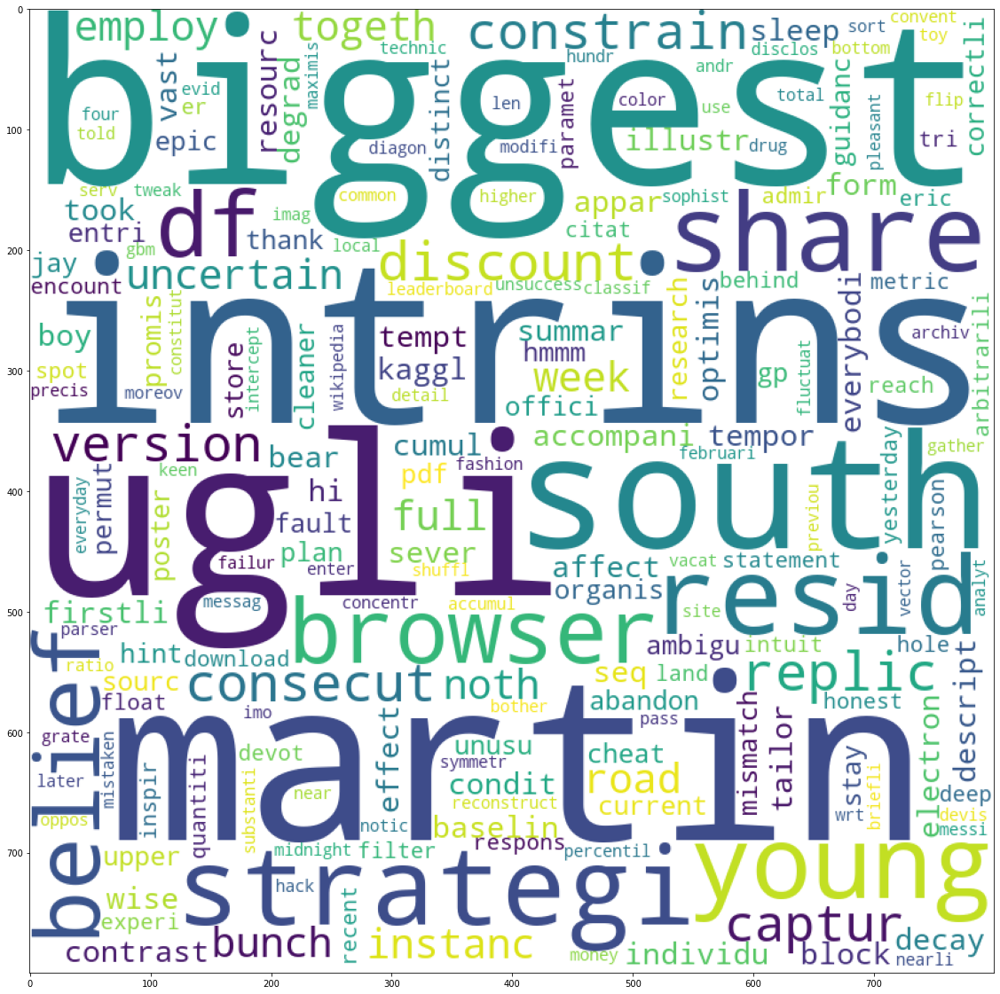

In [ ]:
wordcloud = WordCloud(width = 800, height = 800, 
              background_color ='white', 
              min_font_size = 10)

wordcloud.generate_from_frequencies(topic_all_years)
plt.figure(figsize = (20, 20), facecolor = None) 
plt.imshow(wordcloud)

In [ ]:
topic_in_year = [i for i in topic_all_years if topic_all_years[i] >= 11]
{your_key: topic_all_years[your_key] for your_key in topic_all_years if your_key  in topic_in_year }

{'biggest': 13,
 'martin': 13,
 'intrins': 13,
 'ugli': 13,
 'south': 13,
 'strategi': 13,
 'resid': 13,
 'share': 13,
 'young': 13,
 'browser': 13,
 'belief': 13,
 'pump': 11,
 'df': 13,
 'discount': 13,
 'replic': 13,
 'perceptron': 12,
 'consecut': 13,
 'constrain': 13,
 'captur': 13,
 'version': 13,
 'togeth': 13,
 'week': 13,
 'full': 13,
 'employ': 13,
 'bee': 11,
 'instanc': 13,
 'bunch': 13,
 'dip': 12,
 'expans': 12,
 'justic': 12,
 'noth': 13,
 'ambiti': 11,
 'uncertain': 13,
 'road': 13,
 'accompani': 13,
 'contrast': 13,
 'took': 13,
 'tempor': 13,
 'baselin': 13,
 'sleep': 13,
 'descript': 13,
 'condit': 13,
 'appar': 13,
 'decay': 13,
 'seq': 13,
 'affect': 13,
 'tempt': 13,
 'cumul': 13,
 'illustr': 13,
 'bear': 13,
 'everybodi': 13,
 'individu': 13,
 'sever': 13,
 'firstli': 13,
 'hi': 13,
 'effect': 13,
 'summar': 13,
 'resourc': 13,
 'optimis': 13,
 'vast': 13,
 'form': 13,
 'boy': 13,
 'electron': 13,
 'tailor': 13,
 'block': 13,
 'wise': 13,
 'degrad': 13,
 'kaggl':

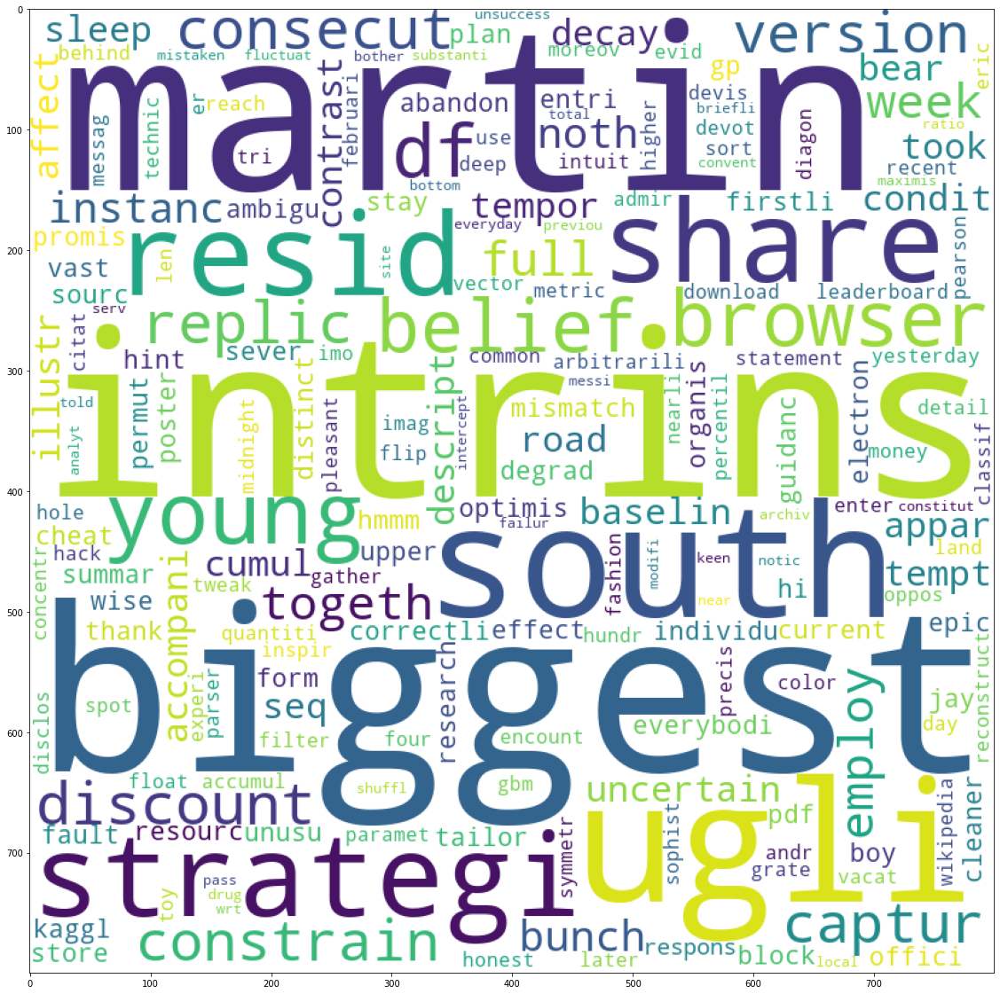

In [ ]:
wordcloud = WordCloud(width = 800, height = 800, 
              background_color ='white', 
              min_font_size = 10)

wordcloud = wordcloud.generate_from_frequencies({your_key: topic_all_years[your_key] for your_key in topic_all_years if your_key  in topic_in_year })
plt.figure(figsize = (20, 20), facecolor = None) 
plt.imshow(wordcloud)

In [ ]:
# embidding_words = gensim.models.Word2Vec(min_count = 1, size = 100, window = 5)
# embidding_words.build_vocab(list(topic_all_years.keys()), progress_per=10000)

In [ ]:
!pip install spacy-transformers # we need to install this package before using the transformes models
!python -m spacy download en_trf_bertbaseuncased_lg
!python -m spacy download en_core_web_lg # Important! you need to restart runtime after install

     |████████████████████████████████| 51 kB 125 kB/s 
     |████████████████████████████████| 451 kB 41.1 MB/s 
     |████████████████████████████████| 3.4 MB 45.8 MB/s 
     |████████████████████████████████| 1.1 MB 49.8 MB/s 
     |████████████████████████████████| 6.0 MB 45.9 MB/s 
     |████████████████████████████████| 628 kB 58.1 MB/s 
     |████████████████████████████████| 181 kB 47.9 MB/s 
     |████████████████████████████████| 42 kB 997 kB/s 
     |████████████████████████████████| 10.1 MB 43.6 MB/s 
     |████████████████████████████████| 596 kB 49.9 MB/s 
     |████████████████████████████████| 3.3 MB 50.2 MB/s 
     |████████████████████████████████| 895 kB 34.4 MB/s 
     |████████████████████████████████| 67 kB 4.0 MB/s 
  Attempting uninstall: catalogue
    Found existing installation: catalogue 1.0.0
    Uninstalling catalogue-1.0.0:
      Successfully uninstalled catalogue-1.0.0
  Attempting uninstall: srsly
    Found existing installation: srsly 1.0.5
    Uninstal


✘ No compatible package found for 'en_trf_bertbaseuncased_lg' (spaCy
v3.2.1)

     |████████████████████████████████| 777.4 MB 5.6 kB/s 
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_lg')


In [ ]:
!python -m spacy download en_core_web_md # Important! you need to restart runtime after install

     |████████████████████████████████| 45.7 MB 1.9 MB/s 
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_md')


In [ ]:
import spacy
from sklearn.manifold import TSNE


/usr/local/lib/python3.7/dist-packages/tensorflow_core/python/framework/dtypes.py:597: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

/usr/local/lib/python3.7/dist-packages/tensorflow_core/python/framework/dtypes.py:605: DeprecationWarning:

`np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

/usr/local/lib/python3.7/dist-packages/tensorflow_core/python/framework/dtypes.py:639: DeprecationWarning:

`np.object` is a deprecated alias for th

In [ ]:
import gensim.downloader as api
model = api.load("word2vec-google-news-300")

[==================================================] 100.0% 1662.8/1662.8MB downloaded


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.7/dist-packages/gensim/models/utils_any2vec.py:212: DeprecationWarning:

The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead

/usr/local/lib/python3.7/dist-packages/gensim/models/utils_any2vec.py:212: DeprecationWarning:

The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead

/usr/local/lib/python3.7/dist-packages/gensim/models/utils_any2vec.py:212: DeprecationWarning:

The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead

/usr/local/lib/python3.7/dist-packages/gensim/models/utils_any2vec.py:212: DeprecationWarning:

The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead

/usr/local/lib/python3.7/dist-packages/gensim/models/utils_any2vec.py:212: DeprecationWarning:

The binar

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



2013


/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional informatio

2014


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you ma

2015


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you ma

2016


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you ma

2017


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you ma

2018


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you ma

2019


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you ma

2020


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you ma

2021


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you ma

2022


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

/usr/local/lib/python3.7/dist-packages/scipy/linalg/decomp_qr.py:20: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you ma

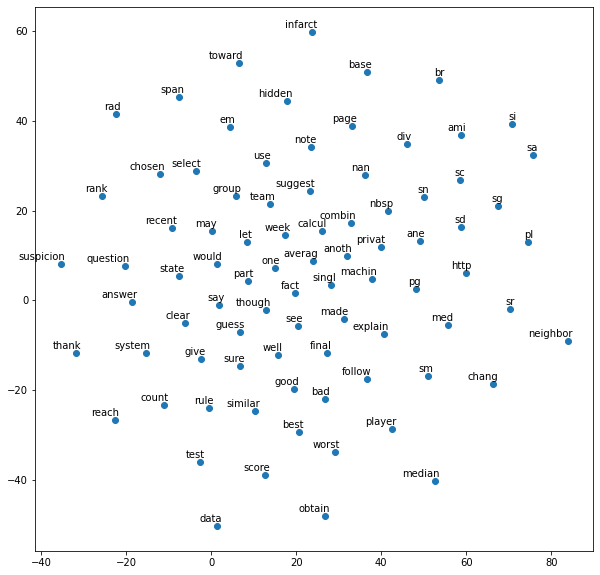

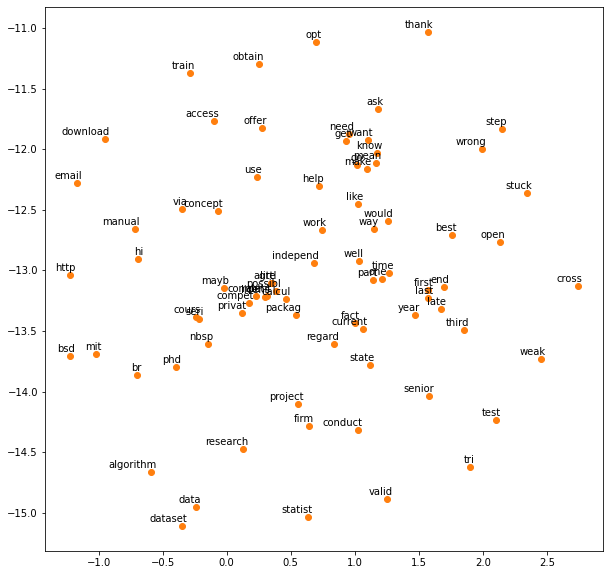

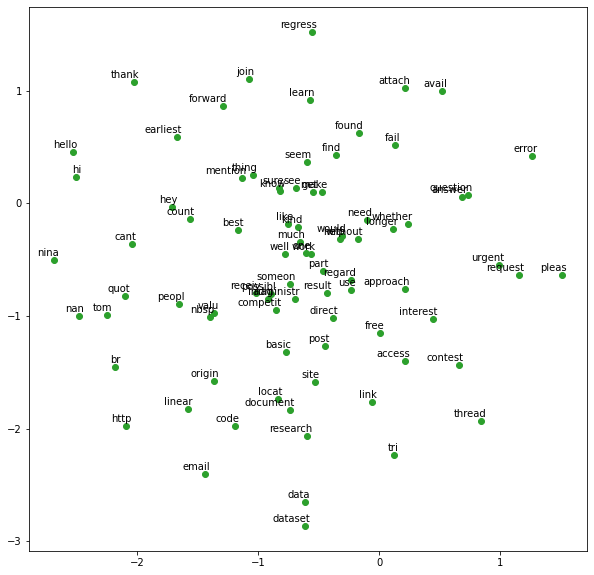

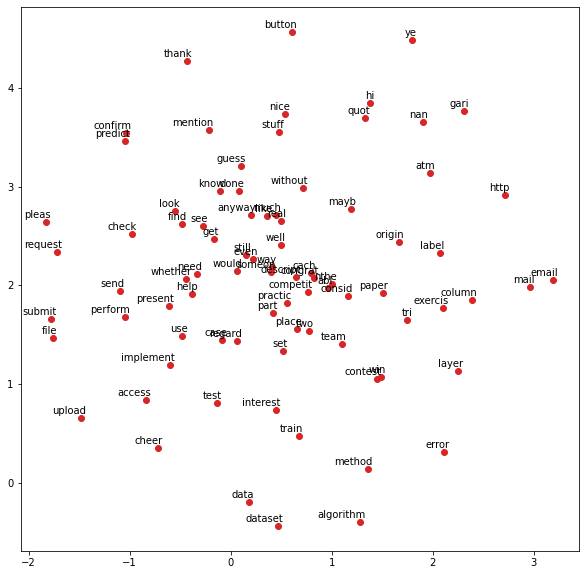

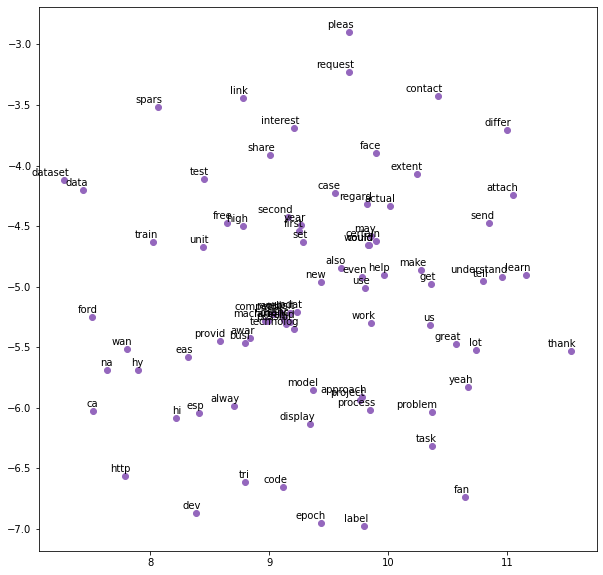

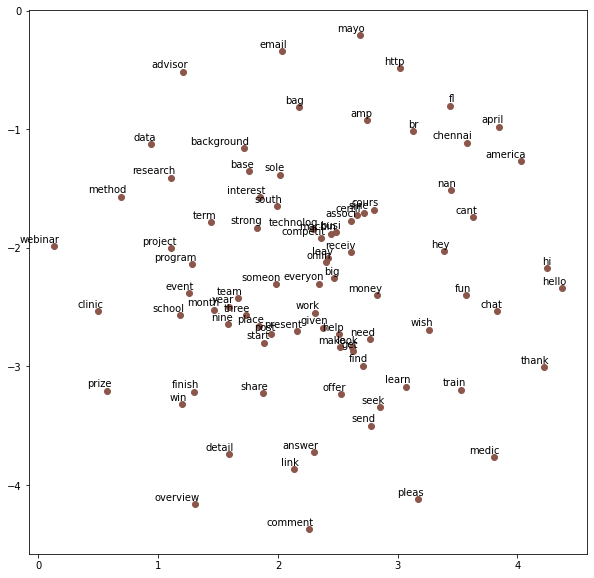

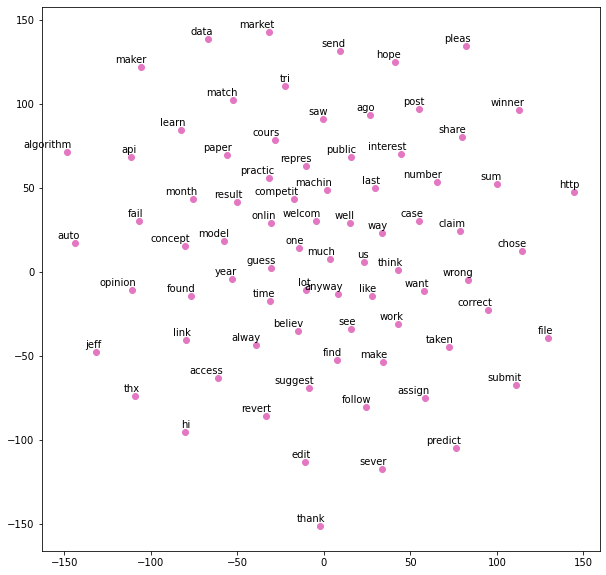

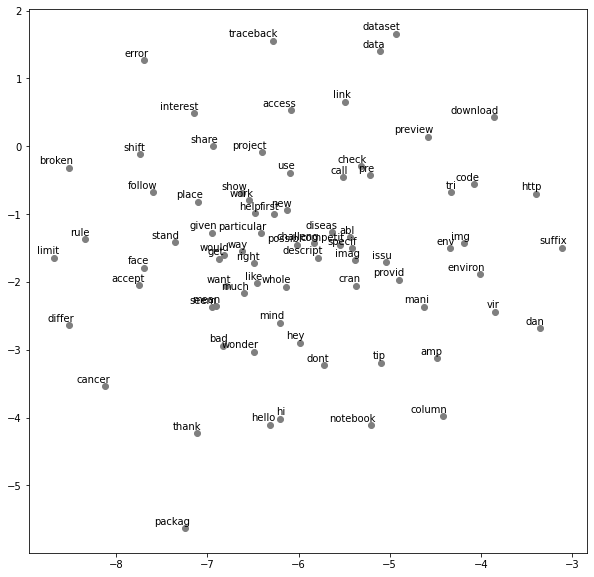

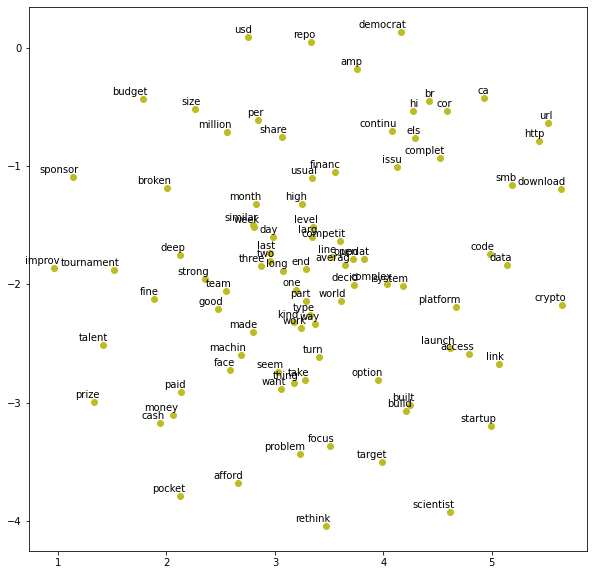

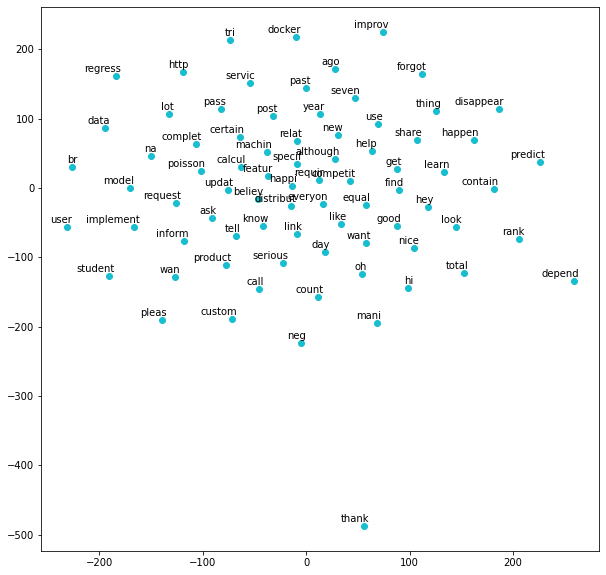

In [ ]:
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']
tsne_model = TSNE(perplexity=40, n_components=2, init='pca', n_iter=2500, random_state=23)

for year, color in zip(list(topics_.keys())[3:], colors):
  print(year)
  topic = list(topics_[year])[:100]
  labels = []
  tokens = []
  for word in topic:
      try:
        tokens.append(model[word])
        labels.append(word)
      except:
        pass
  new_values = tsne_model.fit_transform(tokens)
  x = []
  y = []
  plt.figure(figsize=(10, 10)) 
  for value in new_values:
      x.append(value[0])
      y.append(value[1])
  for i in range(len(x)):
      plt.scatter(x[i],y[i], c=color)
      plt.annotate(labels[i],
                    xy=(x[i], y[i]),
                    xytext=(5, 2),
                    textcoords='offset points',
                    ha='right',
                    va='bottom')
plt.show()
  

In [ ]:
def get_topic_best_match_words(topic_sf, topic_num,n):
    d = {r['vocabulary']: r['topic_probabilities'][topic_num] for r in topics_sf}
    l = sorted(d.items(), key=operator.itemgetter(1), reverse=True)
    return l[:n]
for year in dict_topic_model:
  topics_sf = dict_topic_model[year].topics
  print(get_topic_best_match_words(topics_sf, 18,5))

[('player', 0.14955739046343644), ('div', 0.07368146990998944), ('system', 0.050249200327307286), ('averag', 0.02570110838354503), ('rate', 0.021981700513278024)]
[('nbsp', 0.18945054945056913), ('br', 0.08069478908189424), ('data', 0.03815668202765374), ('number', 0.030641616448071247), ('use', 0.027522155264093608)]
[('br', 0.22491526759677433), ('pleas', 0.027731798954312867), ('em', 0.019981082998346694), ('strong', 0.019061506528994774), ('end', 0.016828249389140116)]
[('train', 0.08212469237080368), ('would', 0.044224774405254484), ('base', 0.03626743232157857), ('avail', 0.027653814602135573), ('problem', 0.026259228876130514)]
[('use', 0.1505453716435215), ('time', 0.04838169603100443), ('set', 0.040829848321850444), ('think', 0.030357002913872756), ('could', 0.029288345219181153)]
[('nbsp', 0.17740731954536706), ('see', 0.04822618559813155), ('inform', 0.03968599711013402), ('calcul', 0.025409217365047223), ('run', 0.023338868640684185)]
[('new', 0.02485259345223257), ('first'

## **Q2 Programming languages**

In [ ]:
url = "https://en.wikipedia.org/wiki/List_of_programming_languages"
s = requests.get(url).content.decode('utf-8')
soup = BeautifulSoup(s, 'html.parser')
words = []
for i in soup.findAll('li')[35:]:
    try:
        words.append(str(i.contents[0].contents[0]))
    except:
        words.append(str(i.contents[0]))
programming_languages = words[:689]
programming_languages = [i.lower() for i in programming_languages ]

In [ ]:
len(programming_languages)

689

In [ ]:
counter_programming_languages = {}
for year in counter_:
  words = counter_[year]
  counter_programming_languages[year] = {i: words[i] for i in dict(words) if i.lower() in programming_languages}

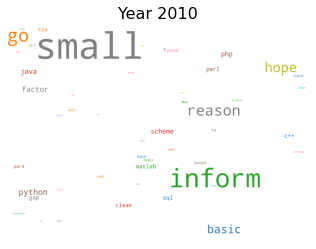

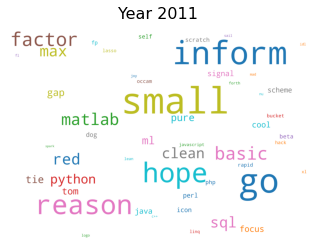

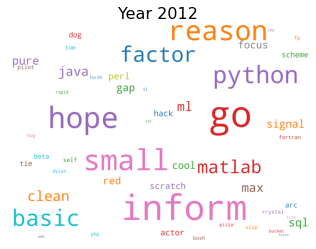

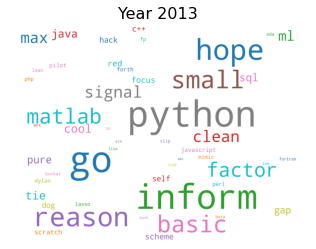

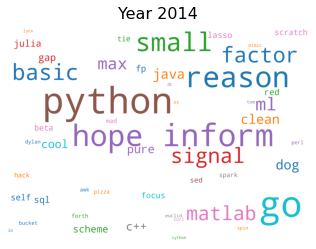

...

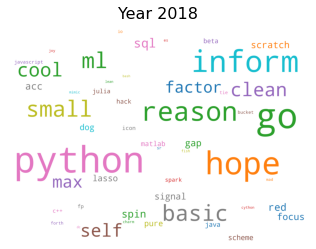

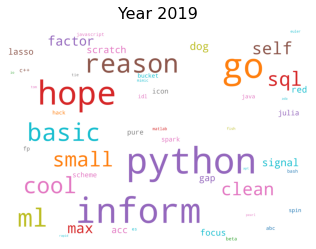

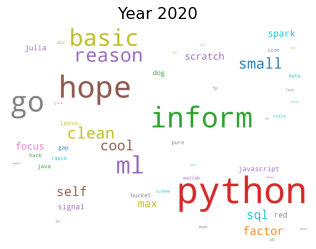

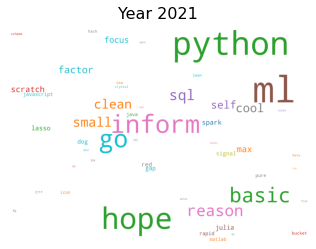

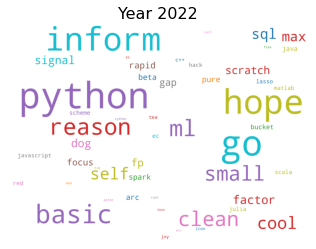

<Figure size 432x288 with 0 Axes>

In [ ]:
for year in counter_programming_languages:
  cloud = WordCloud(background_color='white',
                    width=2500,
                    height=1800,
                    max_words=50,
                    colormap='tab10',
                    prefer_horizontal=1.0)
  cloud.generate_from_frequencies(counter_programming_languages[year], max_font_size=300)
  plt.gca().imshow(cloud)
  plt.gca().set_title('Year ' + str(year), fontdict=dict(size=16))
  plt.gca().axis('off')
  plt.show()
  plt.clf()

In [ ]:
dcit_all = None
for year in counter_programming_languages:
  if dcit_all is None:
    dcit_all = counter_programming_languages[year]
  else:
    dcit_all = {**dcit_all, **counter_programming_languages[year]}
    

In [ ]:
dcit_all_ = {i:dcit_all[i] for i in dcit_all if dcit_all[i] > 100}

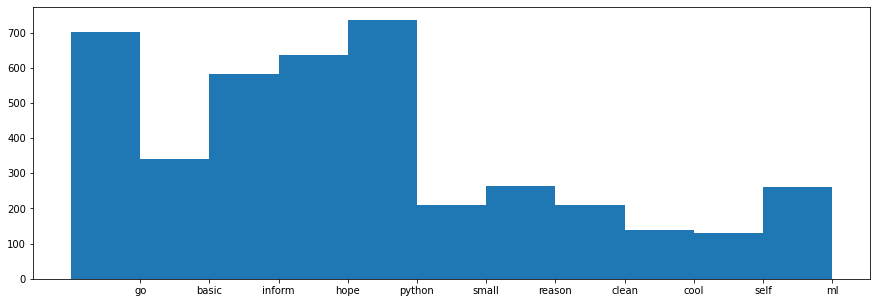

In [ ]:
labels, values = zip(*dcit_all_.items())

indexes = np.arange(len(labels))
width = 1

plt.figure(figsize=(15, 5))
plt.bar(indexes, values, width)
plt.xticks(indexes + width *0.5, labels)
plt.show()


In [ ]:
counter_programming_languages[year]

{'acc': 4,
 'actor': 5,
 'agora': 1,
 'ampl': 1,
 'apt': 3,
 'arc': 24,
 'bash': 2,
 'basic': 342,
 'beta': 26,
 'bliss': 1,
 'bucket': 17,
 'c++': 12,
 'charm': 1,
 'chuck': 2,
 'clean': 211,
 'cool': 138,
 'crystal': 2,
 'curl': 4,
 'cython': 4,
 'dc': 1,
 'dog': 60,
 'ec': 14,
 'elm': 1,
 'es': 5,
 'escher': 2,
 'euler': 1,
 'factor': 65,
 'faust': 1,
 'fish': 2,
 'flex': 4,
 'focus': 35,
 'forth': 3,
 'fortran': 1,
 'fp': 50,
 'gap': 43,
 'go': 701,
 'gödel': 2,
 'hack': 13,
 'hop': 3,
 'hope': 635,
 'icon': 7,
 'inform': 582,
 'io': 3,
 'java': 17,
 'javascript': 13,
 'joy': 8,
 'julia': 14,
 'jython': 1,
 'ladder': 2,
 'lasso': 13,
 'lean': 4,
 'lil': 1,
 'lisa': 1,
 'logo': 2,
 'lpc': 1,
 'lua': 1,
 'lynx': 1,
 'mad': 4,
 'magma': 1,
 'matlab': 13,
 'max': 87,
 'maxima': 3,
 'mimic': 3,
 'ml': 262,
 'nim': 2,
 'pascal': 2,
 'php': 3,
 'pike': 2,
 'pure': 26,
 'python': 736,
 'rapid': 35,
 'reason': 264,
 'red': 13,
 'rust': 4,
 'scala': 14,
 'scheme': 14,
 'scratch': 54,
 'self'

In [ ]:
for year in counter_programming_languages:
  print(max(counter_programming_languages[year], key=counter_programming_languages[year].get))

small
small
go
go
python
go
go
go
python
python
python
ml
python


In [ ]:
!pip freeze >> install.txt

In [ ]:
packge = []
with open('install.txt', "r") as f:
  for i in f:
    packge.append(i.split("=")[0].split(" ")[0].lower())

In [ ]:
len(packge)

417

In [ ]:
counter_packge = {}
for year in counter_:
  words = counter_[year]
  counter_packge[year] = {i: words[i] for i in dict(words) if i.lower() in packge}

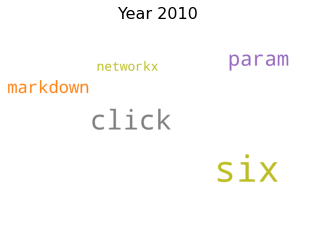

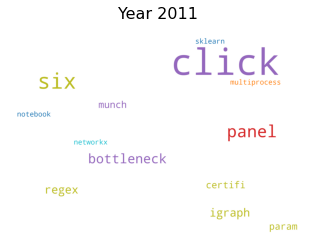

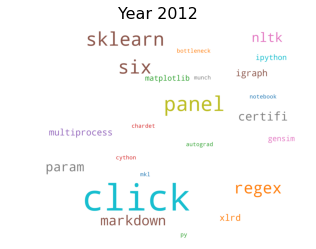

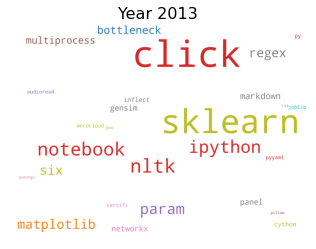

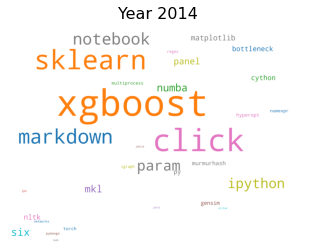

...

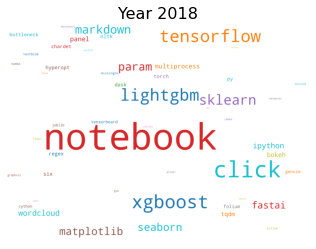

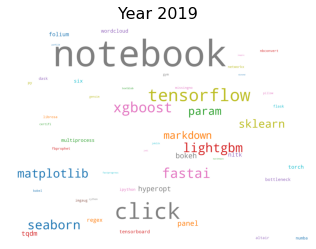

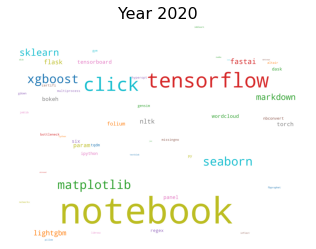

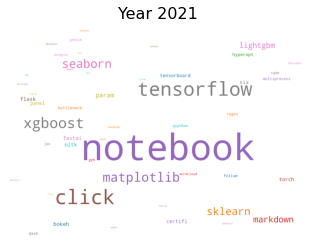

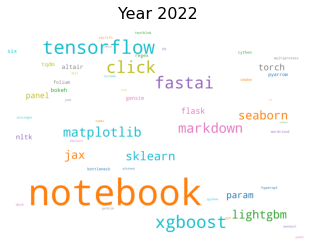

<Figure size 432x288 with 0 Axes>

In [ ]:
for year in counter_programming_languages:
  cloud = WordCloud(background_color='white',
                    width=2500,
                    height=1800,
                    max_words=50,
                    colormap='tab10',
                    prefer_horizontal=1.0)
  cloud.generate_from_frequencies(counter_packge[year], max_font_size=300)
  plt.gca().imshow(cloud)
  plt.gca().set_title('Year ' + str(year), fontdict=dict(size=16))
  plt.gca().axis('off')
  plt.show()
  plt.clf()

# **athlete_events**

In [ ]:
!mkdir ./datasets
!mkdir ./datasets/120-years-of-olympic-history-athletes-and-results
!kaggle datasets download heesoo37/120-years-of-olympic-history-athletes-and-results -p ./datasets/120-years-of-olympic-history-athletes-and-results/

mkdir: cannot create directory ‘./datasets’: File exists
  0% 0.00/5.43M [00:00<?, ?B/s]
100% 5.43M/5.43M [00:00<00:00, 80.2MB/s]


In [ ]:
!unzip ./datasets/120-years-of-olympic-history-athletes-and-results/*.zip  -d ./datasets/120-years-of-olympic-history-athletes-and-results

Archive:  ./datasets/120-years-of-olympic-history-athletes-and-results/120-years-of-olympic-history-athletes-and-results.zip
  inflating: ./datasets/120-years-of-olympic-history-athletes-and-results/athlete_events.csv  
  inflating: ./datasets/120-years-of-olympic-history-athletes-and-results/noc_regions.csv  


<Figure size 432x288 with 0 Axes>

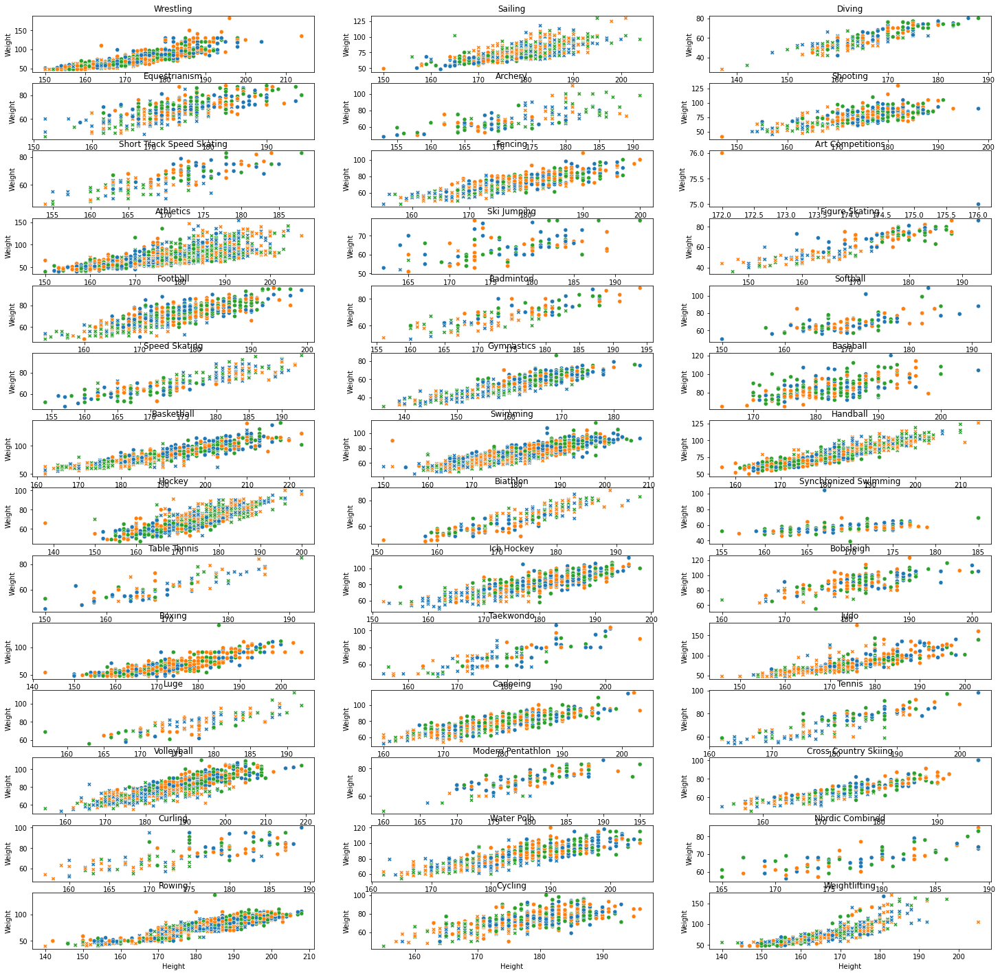

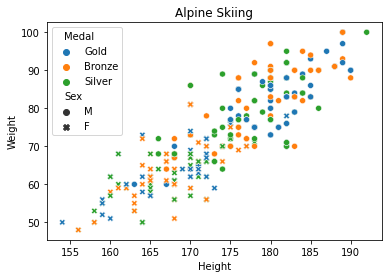

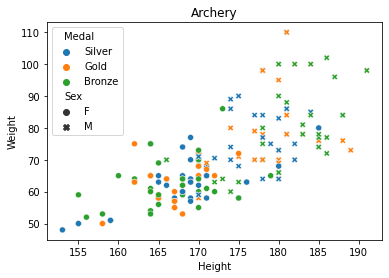

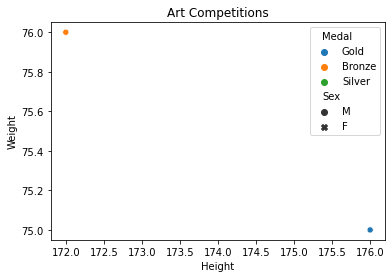

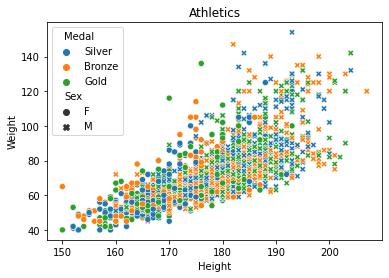

...

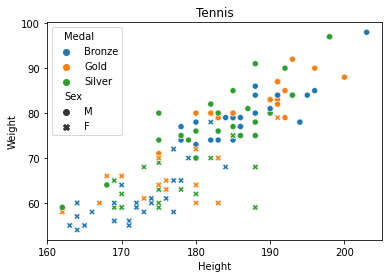

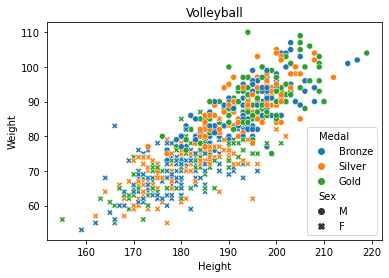

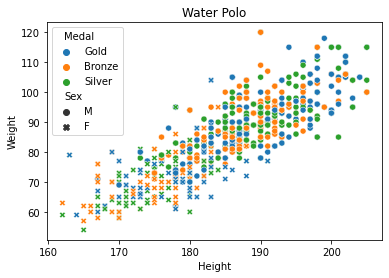

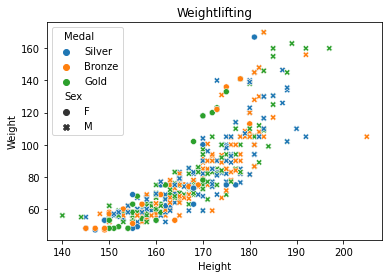

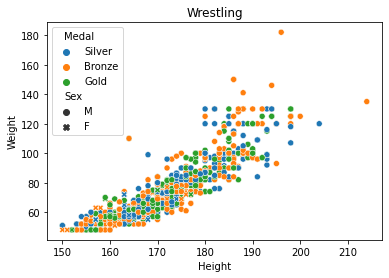

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

df_ole = pd.read_csv('./datasets/120-years-of-olympic-history-athletes-and-results/athlete_events.csv')
df_ole_sport = df_ole.groupby("Sport")
df_ole_sport_ = []
for i in df_ole_sport:
    data = i[1]
    sport = i[0]
    if data[data['Medal'].isin(['Bronze', 'Gola', 'Silver'])].shape[0] > 100:
        df_ole_sport_.append((sport, data))

f = plt.figure()
f, axes = plt.subplots(nrows=len(df_ole_sport_) // 3, ncols=3, figsize=(2, 15))
f.set_figheight(25)
f.set_figwidth(25)
rows = 0
col = 0
for i in df_ole_sport_:
    data = i[1]
    sport = i[0]
    scatter = sns.scatterplot(ax=axes[rows][col], x="Height", y="Weight",
                    hue="Medal", style='Sex', data=data, legend= False)
    scatter.set_title(f"{sport}")
    rows += 1
    col += 1
    if rows == len(df_ole_sport_) // 3:
        rows = 0
    if col == 3:
        col = 0
plt.show()


for i in df_ole_sport_:
    data = i[1]
    sport = i[0]
    scatter = sns.scatterplot(x="Height", y="Weight",
                    hue="Medal", style='Sex', data=data)
    scatter.set_title(f"{sport}")
    plt.show()


In [ ]:
df_ole_sport

In [ ]:
df_ole[(df_ole['Sport']=='Rowing') & (df_ole['Weight']>110) & (df_ole['Medal']=='Gold')]

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal
83621,42503,"Edwin Darius ""Ed"" Graves, Jr.",M,22.0,185.0,137.0,United States,USA,1920 Summer,1920,Summer,Antwerpen,Rowing,Rowing Men's Coxed Eights,Gold
